Auxiliary Classifier Generative Adversarial Network

ACGANs have:
- A generator model that takes in noise and a label and outputs an image. For example, the noise is a 100-dimension vector from an uniform distribution and the label is something like '0' or '5'. The idea is that the label should tell the generator what to make and the noise provides the variance within the images.
- A discriminator model that tries to tell the difference between fake images from the generator and real images from a dataset; it also tries to classify the images.

Experiment Details:
- Uses the MNIST handwriting dataset.
- Discriminator uses Stochastic Gradient Descent while Generator uses Adam.

Problems with this experiment:
- Mode collapse within a label happens to often. The noise vector does not vary the digits. Unlike the reference material, the MNIST handwriting dataset may lack that variance of the MNIST fashion dataset, which may cause mode collapse.
- The generator model has trouble making some digits, such as '9', where it forgets its straight line.
- Loss from classification mistakes seem to disappear too quickly when training. Soon, the only loss comes from real/fake mistakes.

Based on:
https://machinelearningmastery.com/how-to-develop-an-auxiliary-classifier-gan-ac-gan-from-scratch-with-keras/

Implemented Some Suggestions From: https://github.com/soumith/ganhacks

In [ ]:
#Parameters
BATCH_SIZE=256
BUFFER_SIZE=10000

In [ ]:
#Load dataset
import tensorflow as tf
import numpy as np


(train_images, train_labels), (test_images, test_labels) = tf.keras.datasets.mnist.load_data()
realImages = (np.concatenate([test_images,train_images]).astype('float32')) / 255.0
realLabels = np.concatenate([test_labels,train_labels])
dataset = tf.data.Dataset.from_tensor_slices((realImages,realLabels)).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [ ]:
#Definitions
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2


def build_discriminator():
  input = Input(shape=(28,28,1))

  def buildConvLayer(model,i,k=4,s=2,d=0.5):
    model = Conv2D(i,kernel_size=k,strides=s,padding='same',use_bias=False,kernel_regularizer=l2(1e-8))(model)
    model = BatchNormalization()(model)
    model = LeakyReLU()(model)
    model = Dropout(d)(model)
    return model
  model = buildConvLayer(input,128)
  model = buildConvLayer(model,128)
  model = Flatten()(model)
  model = Dropout(0.5)(model)

  outRealOrFake = Dense(1,activation='sigmoid')(model)
  outLabel = Dense(10,activation='softmax')(model)

  completeModel = Model(input,[outRealOrFake,outLabel])
  
  losses = [BinaryCrossentropy(),
            SparseCategoricalCrossentropy()]
  opt = SGD()
  completeModel.compile(loss=losses,optimizer=opt)
  return completeModel

def build_generator():
  inputNoise = Input(shape=(100,))
  noisePart = Dense(7*7*510,kernel_regularizer=l2(1e-8))(inputNoise)
  noisePart = Reshape((7,7,510))(noisePart)

  inputLabel = Input(shape=(1,))
  labelPart = Embedding(10,100,embeddings_regularizer=l2(1e-8))(inputLabel)
  labelPart = Dense(7*7*2,kernel_regularizer=l2(1e-8))(labelPart)
  labelPart = Reshape((7,7,2))(labelPart)

  def buildConvTranposeLayer(model,i,k=4,s=2,d=0.25,p='same'):
    model = Conv2DTranspose(i,kernel_size=k,strides=s,padding=p,use_bias=False,kernel_regularizer=l2(1e-8))(model)
    model = BatchNormalization()(model)
    model = LeakyReLU()(model)
    model = Dropout(d)(model)
    return model

  model = Concatenate()([noisePart,labelPart])
  model = buildConvTranposeLayer(model,256,5,2,0.5)
  outLayer = Conv2DTranspose(1,activation='sigmoid',kernel_size=5,strides=2,padding='same')(model)
  return Model([inputNoise,inputLabel],outLayer)


def build_gan(discriminator,generator):
  discriminator.trainable = False
  output = discriminator(generator.output)

  completeModel = Model(generator.input,output)
  losses = [BinaryCrossentropy(),
            SparseCategoricalCrossentropy()]
  opt = Adam()
  completeModel.compile(loss=losses,optimizer=opt)
  return completeModel

In [ ]:
import tensorflow as tf
from matplotlib import pyplot as  plt
from tensorflow.keras.losses import BinaryCrossentropy, SparseCategoricalCrossentropy
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.random import normal,uniform
from tensorflow import GradientTape
from tensorflow.keras.preprocessing.image import array_to_img


def getNoise(l):
  return normal([l,100])


def getFakeLabels(l):
  return uniform([l],minval=0,maxval=10,dtype=tf.dtypes.int32)


def step(gen,dis,gan,realsImage,realsLabel):
  batchLength = len(realsImage)

  zeros = tf.zeros([batchLength])+0.1
  ones = tf.ones([batchLength])-0.1

  noise = getNoise(batchLength)
  fakesLabel = getFakeLabels(batchLength)
  fakesImage = gen([noise,fakesLabel])


  _,dr1,dr2 = dis.train_on_batch(realsImage,[ones, realsLabel])
  _,df1,df2 = dis.train_on_batch(fakesImage,[zeros,fakesLabel])


  noise = getNoise(batchLength)
  fakesLabel = getFakeLabels(batchLength)

  _,g1,g2 = gan.train_on_batch([noise,fakesLabel],[ones, fakesLabel])


  return (dr1,dr2,df1,df2,g1,g2)

def getImages(gen,display=False,save=False,epoch=0):
  noise = getNoise(100)
  labels = tf.constant([0,1,2,3,4,5,6,7,8,9]*10)
  predictions = gen([noise,labels], training=False)
  images = [array_to_img(p) for p in predictions]
  fig = plt.figure(figsize=(10,10))
  for i in range(100):
    plt.subplot(10,10,i+1)
    plt.imshow(images[i], cmap='gray')
    plt.axis('off')
  if save:
    plt.savefig(f'out/output{epoch:04d}.jpg')
  if display:
    plt.show()

def epoch(gen,dis,gan,dataset,epochs,history={}):
  if not 'gLoss' in history:
    history['gLoss'] = np.array([])
  if not 'dLoss' in history:
    history['dLoss'] = np.array([])

  for e in range(epochs):
    for images,labels in dataset:
      a = step(gen,dis,gan,images,labels)
    print(e,a)
    shouldDisplay = True
    getImages(gen,shouldDisplay,True,e)
  return history

mkdir: cannot create directory ‘out’: File exists


/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/indexed_slices.py:434: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


0 (0.9354153275489807, 0.25879713892936707, 0.8099656701087952, 0.06263397634029388, 1.2943967580795288, 0.18461044132709503)


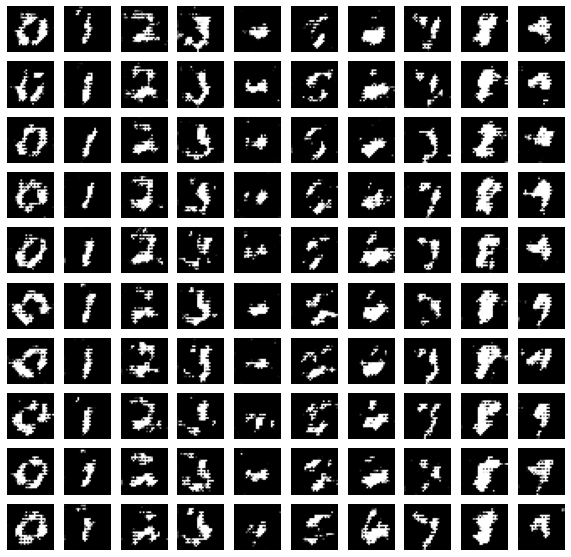

1 (0.40211954712867737, 0.5194306969642639, 0.43342164158821106, 0.016544027253985405, 0.9879434704780579, 0.030685236677527428)


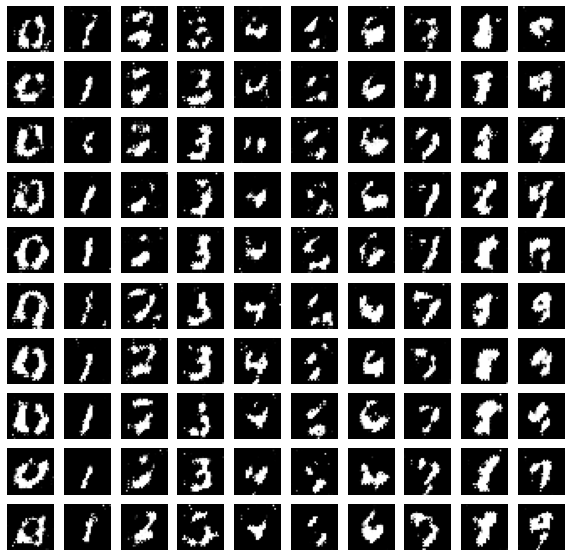

2 (0.4227111041545868, 0.3580641746520996, 0.4161470830440521, 0.00987829826772213, 0.6866117119789124, 0.02180616930127144)


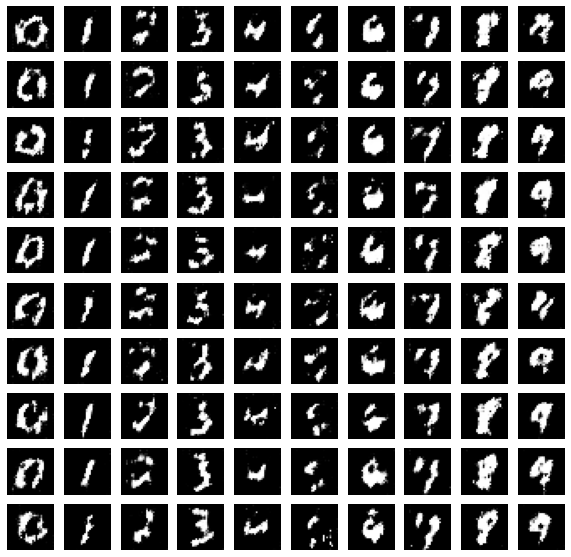

3 (0.3980849087238312, 0.34137067198753357, 0.4042325019836426, 0.01158073078840971, 0.8774948120117188, 0.01731848530471325)


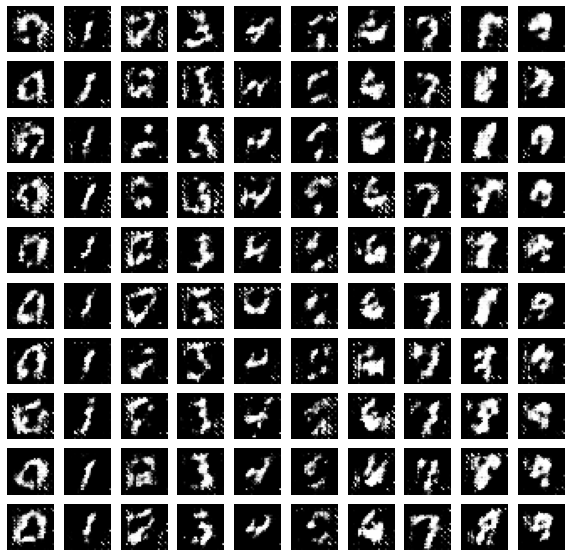

4 (0.38153722882270813, 0.20702706277370453, 0.4132890999317169, 0.011860685423016548, 0.49545732140541077, 0.006609933916479349)


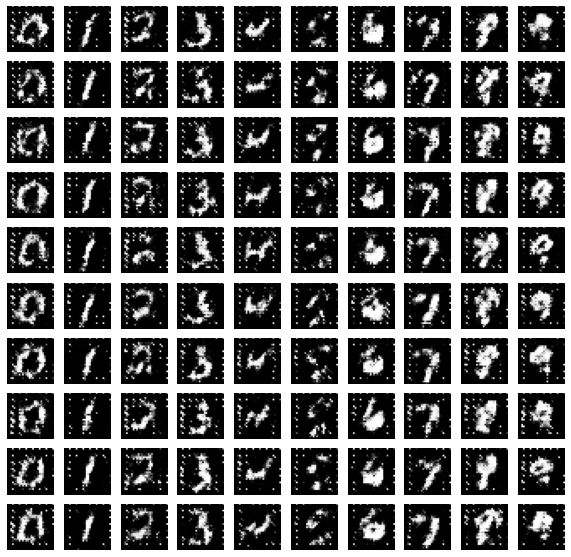

5 (0.3418409824371338, 0.29507187008857727, 0.34912440180778503, 0.007715961895883083, 1.0770833492279053, 0.008706928230822086)


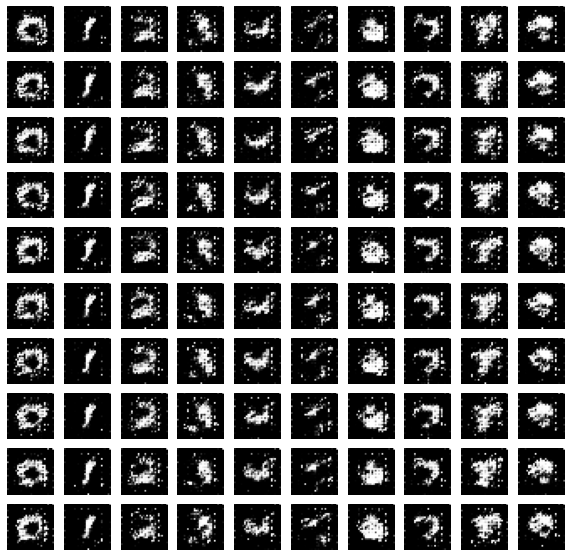

6 (0.34355565905570984, 0.11673296988010406, 0.3691539764404297, 0.0025935738813132048, 0.43555840849876404, 0.005366168450564146)


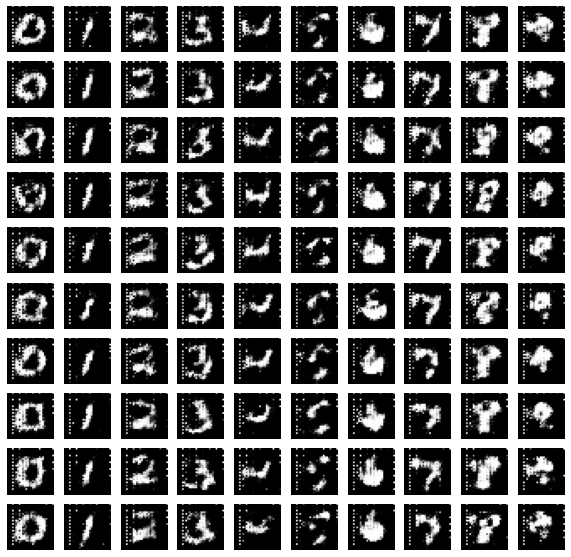

7 (0.3386225700378418, 0.11760812252759933, 0.3629537522792816, 0.002631793264299631, 0.7281323671340942, 0.005215593613684177)


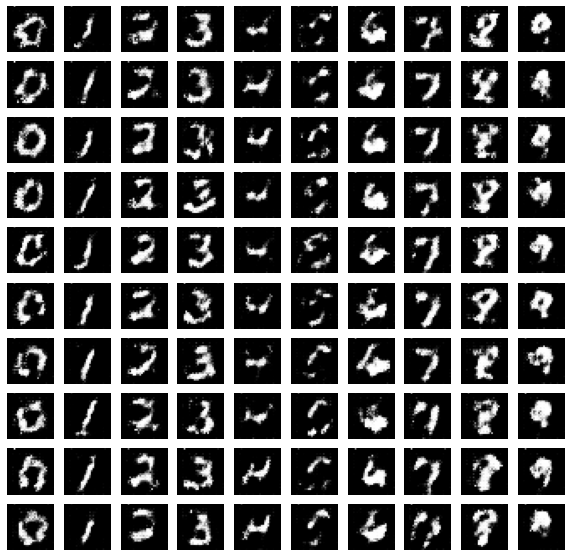

8 (0.341660737991333, 0.17707081139087677, 0.36409029364585876, 0.01007906999439001, 0.7506979703903198, 0.006822911556810141)


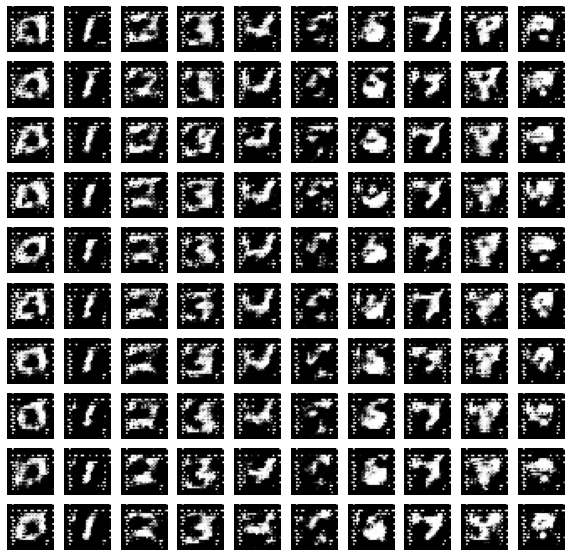

9 (0.36863183975219727, 0.12195710092782974, 0.3576865792274475, 0.008368718437850475, 0.9383538365364075, 0.006626301445066929)


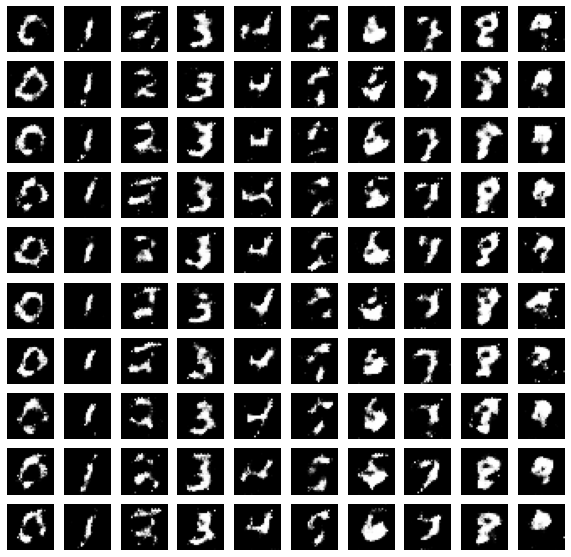

10 (0.3347780406475067, 0.4737990200519562, 0.3454095423221588, 0.006999876815825701, 1.090643286705017, 0.003412456950172782)


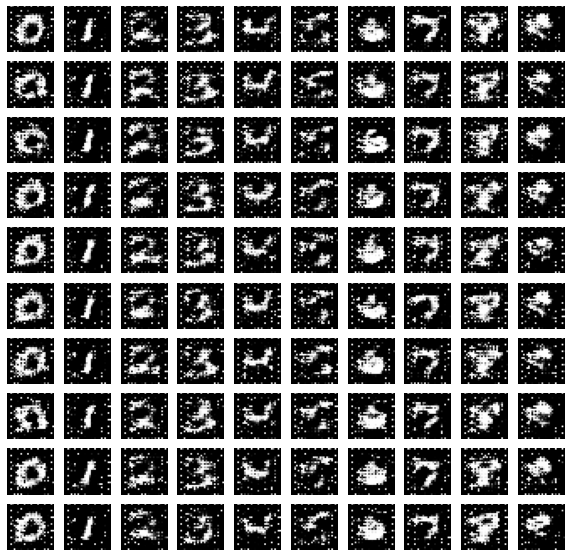

11 (0.35446637868881226, 0.18455757200717926, 0.37124162912368774, 0.016678325831890106, 0.6848478317260742, 0.004687436390668154)


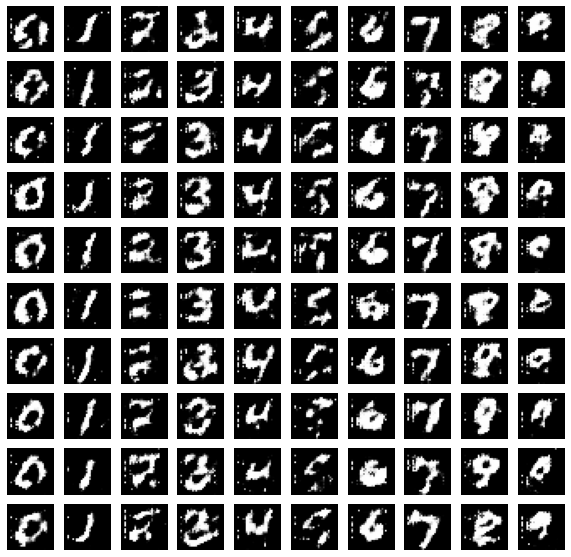

12 (0.33583760261535645, 0.22906534373760223, 0.34892702102661133, 0.008094063960015774, 0.9732592701911926, 0.005774921737611294)


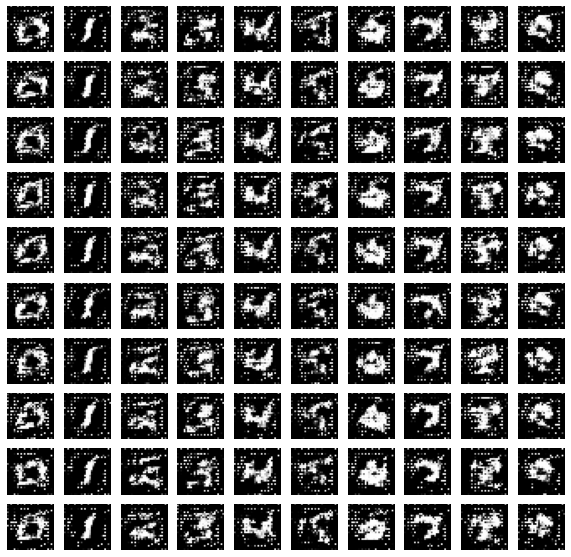

13 (0.4081405997276306, 0.07449398934841156, 0.42479556798934937, 0.012683638371527195, 1.134147047996521, 0.00520806759595871)


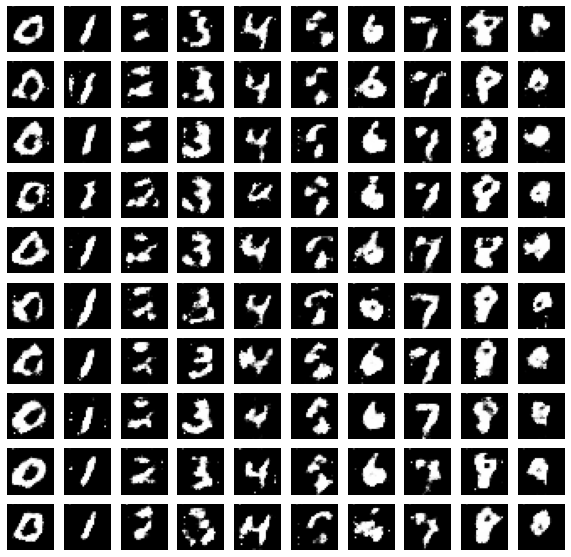

14 (0.338701993227005, 0.3794793486595154, 0.37100979685783386, 0.003790993243455887, 0.5315365791320801, 0.0011858766665682197)


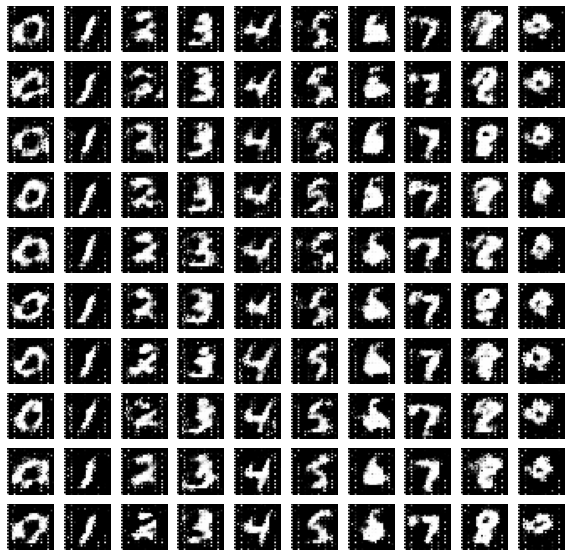

15 (0.3378126621246338, 0.039284270256757736, 0.34773632884025574, 0.0070531233213841915, 0.5983229279518127, 0.0036938663106411695)


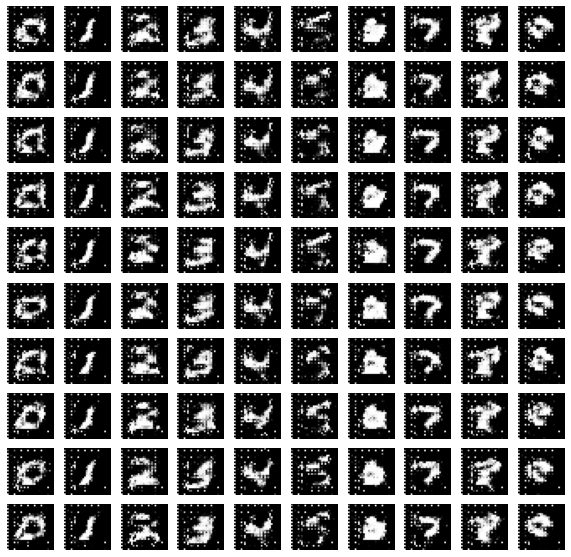

16 (0.335673063993454, 0.2449330985546112, 0.37427935004234314, 0.003003650112077594, 0.7585157752037048, 0.002961031859740615)


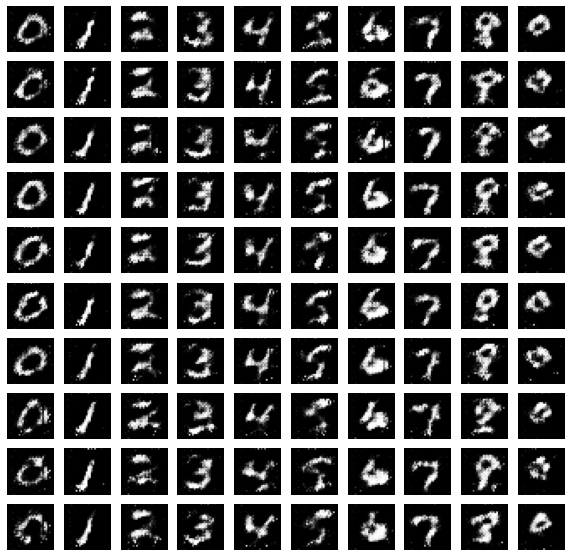

17 (0.4129350185394287, 0.13811585307121277, 0.38193103671073914, 0.006140240468084812, 0.8542171120643616, 0.003957121167331934)


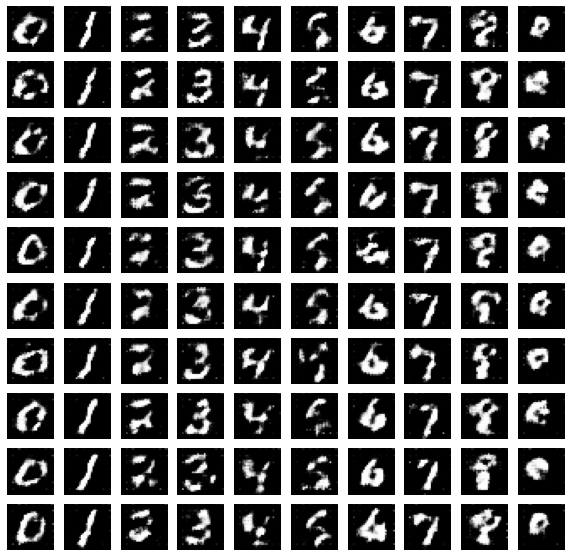

18 (0.3598501980304718, 0.12349309027194977, 0.35538554191589355, 0.012176151387393475, 0.8381929993629456, 0.011295401491224766)


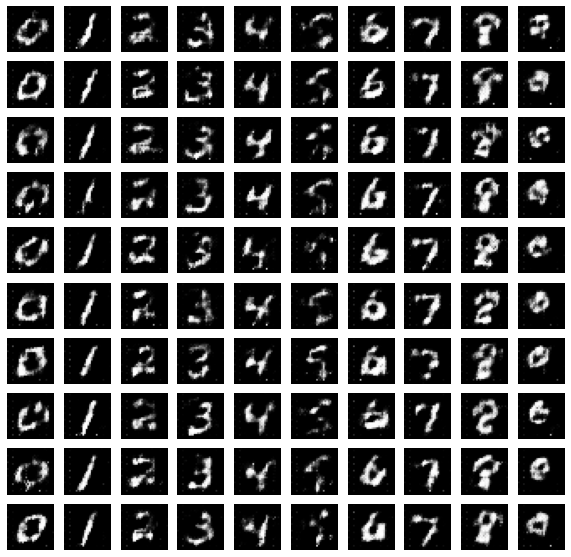

19 (0.35230615735054016, 0.11088386923074722, 0.34458065032958984, 0.003653196385130286, 0.7248581051826477, 0.001768845017068088)


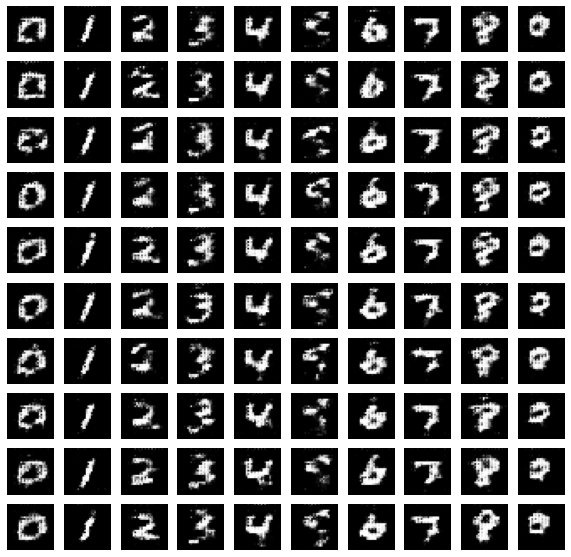

20 (0.34539109468460083, 0.07288135588169098, 0.36040249466896057, 0.0035791625268757343, 0.41438499093055725, 0.002716433024033904)


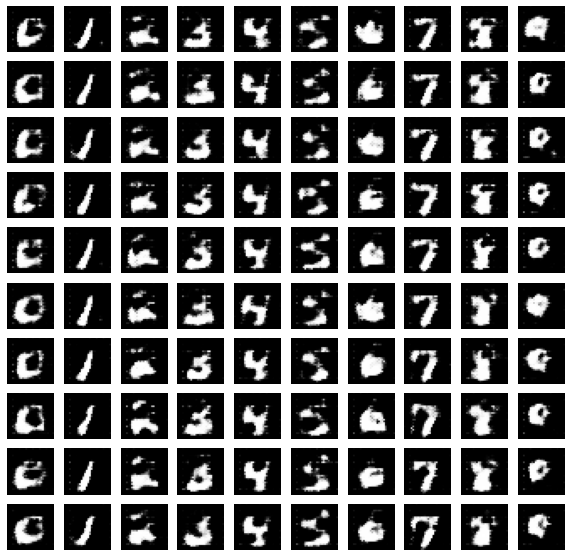

21 (0.33387312293052673, 0.13942602276802063, 0.34078583121299744, 0.006280962377786636, 0.4858264625072479, 0.02950172685086727)


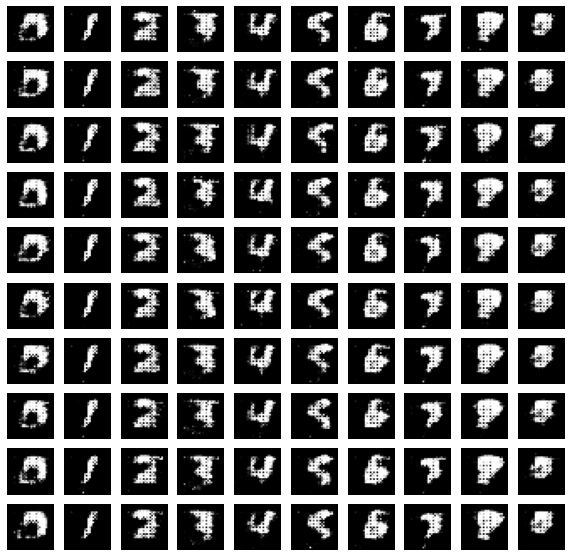

22 (0.3333645164966583, 0.2181486189365387, 0.36027953028678894, 0.002025223569944501, 0.6459747552871704, 0.0022057737223803997)


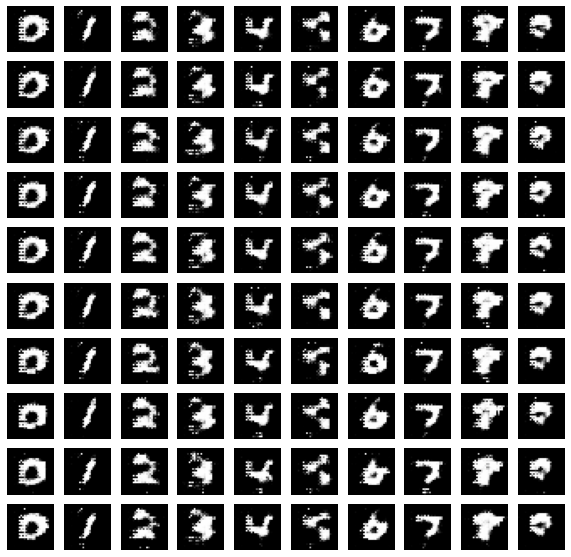

23 (0.33220046758651733, 0.1325148642063141, 0.33782753348350525, 0.0011226254282519221, 0.6236706376075745, 0.0028280748520046473)


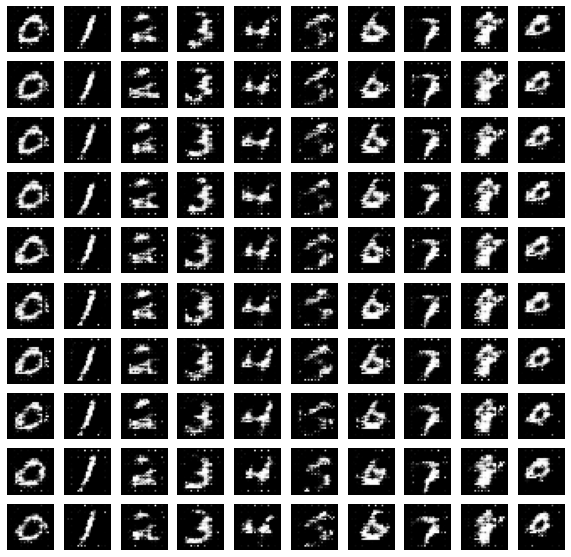

24 (0.4913422167301178, 0.06224926561117172, 0.528251588344574, 0.028533702716231346, 0.7315217852592468, 0.05310283228754997)


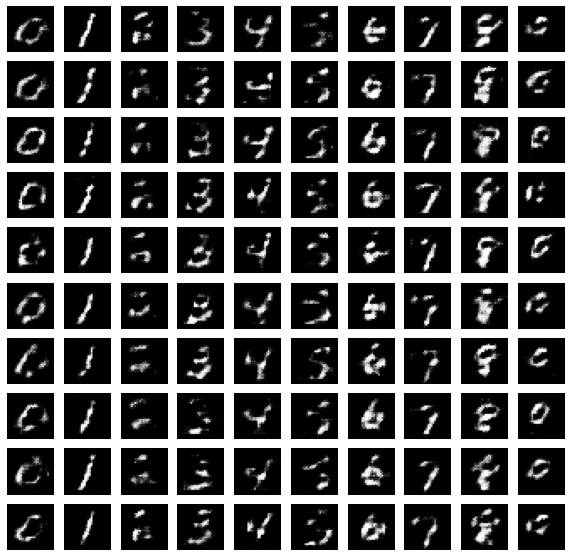

25 (0.332302987575531, 0.0370863638818264, 0.34688693284988403, 0.002661255421116948, 0.6269752383232117, 0.007345705293118954)


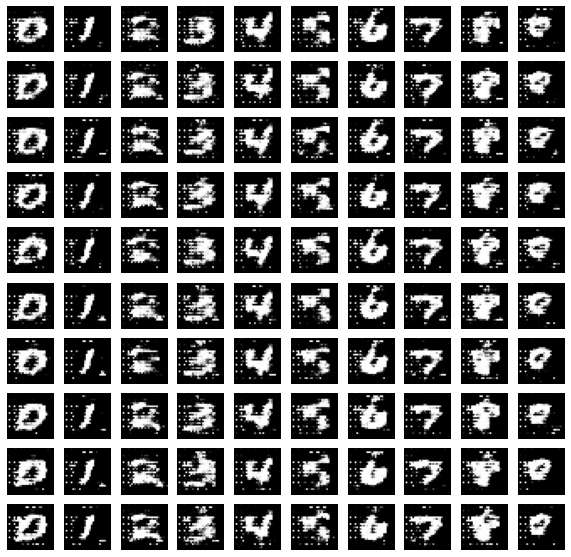

26 (0.34213703870773315, 0.1762598752975464, 0.3603696823120117, 0.003793578129261732, 0.5219531655311584, 0.01528411079198122)


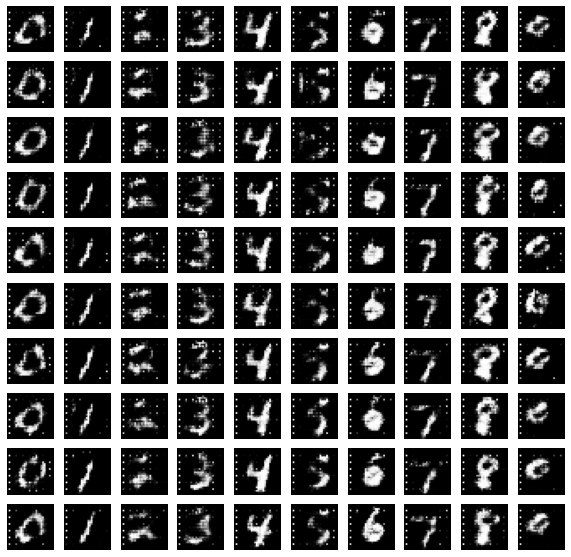

27 (0.33382144570350647, 0.17020104825496674, 0.3505619466304779, 0.0027434262447059155, 0.6386836171150208, 0.0046594031155109406)


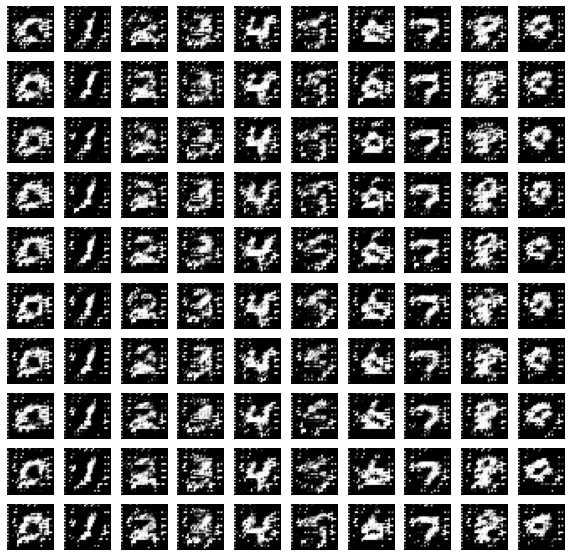

28 (0.3351289927959442, 0.1342228800058365, 0.34479808807373047, 0.0014694221317768097, 0.6901130080223083, 0.0011916619259864092)


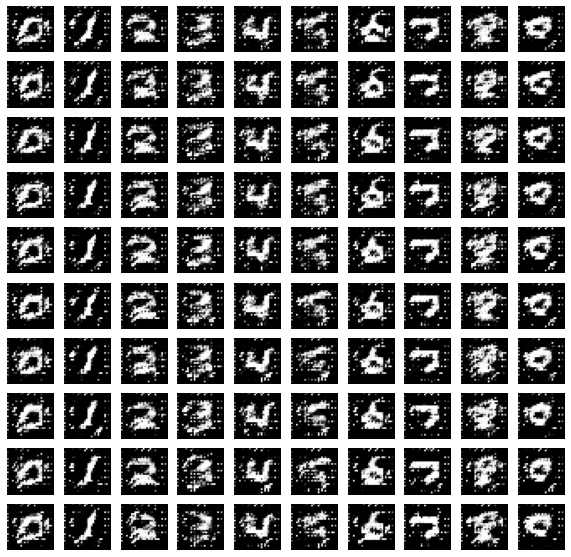

29 (0.33374714851379395, 0.1398230344057083, 0.34946209192276, 0.0009392999927513301, 0.6354861259460449, 0.0033749875146895647)


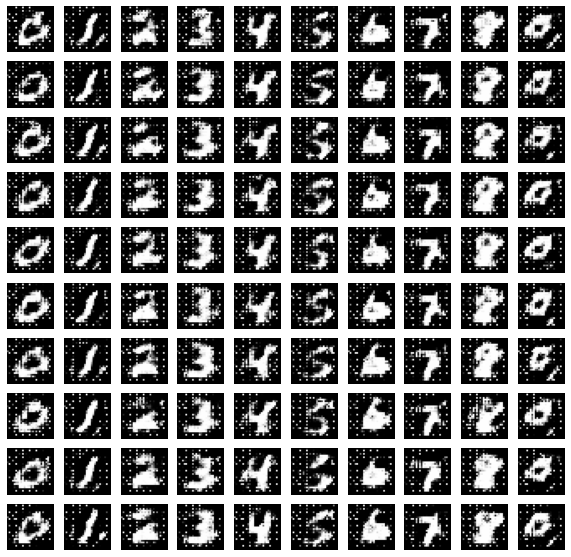

30 (0.3357026278972626, 0.09843505918979645, 0.35387516021728516, 0.00043479338637553155, 0.6812124252319336, 0.00212148018181324)


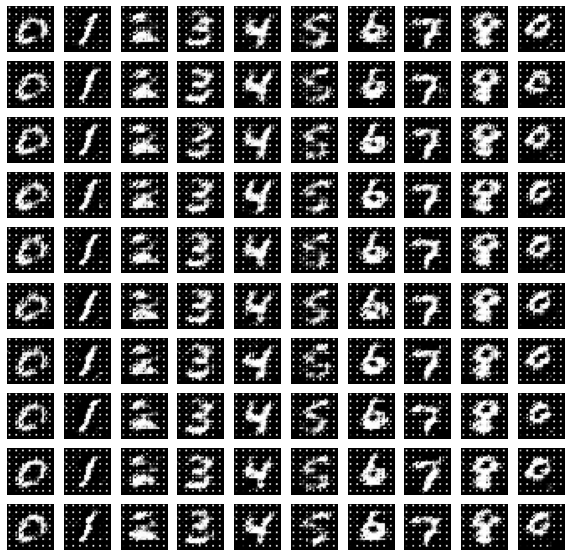

31 (0.33101886510849, 0.15739263594150543, 0.3456244468688965, 0.0008847338031046093, 0.6656500101089478, 0.0008295118459500372)


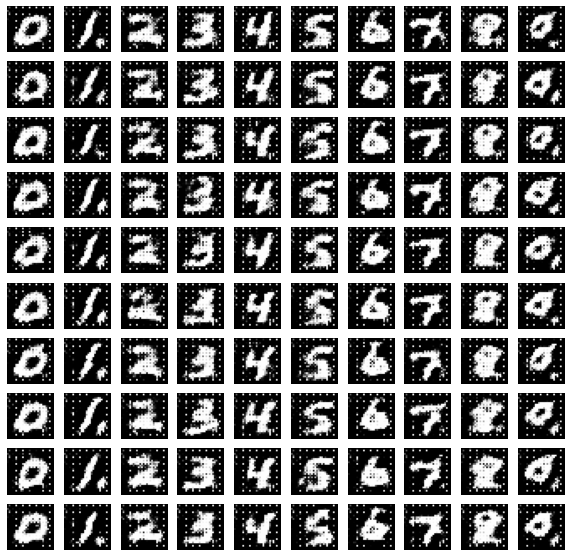

32 (0.36661431193351746, 0.0883464366197586, 0.35266703367233276, 0.0011749740224331617, 0.8108678460121155, 0.00039117265259847045)


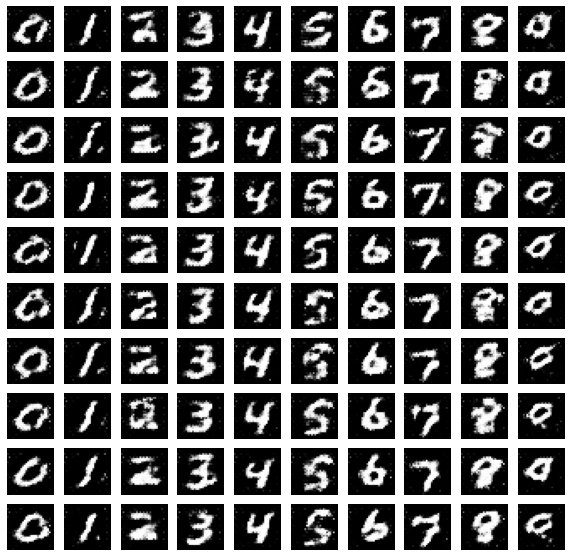

33 (0.33381494879722595, 0.1508621871471405, 0.350698858499527, 0.001007254351861775, 0.6561741232872009, 0.024141009896993637)


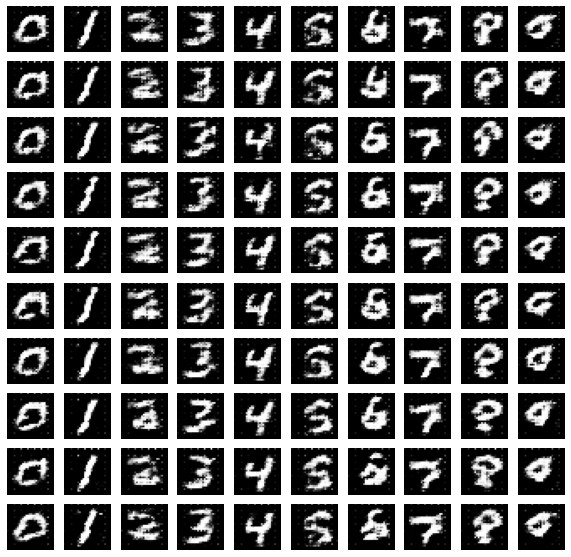

34 (0.3387724757194519, 0.16052986681461334, 0.35067370533943176, 0.0009387611062265933, 0.4788474440574646, 0.002221055328845978)


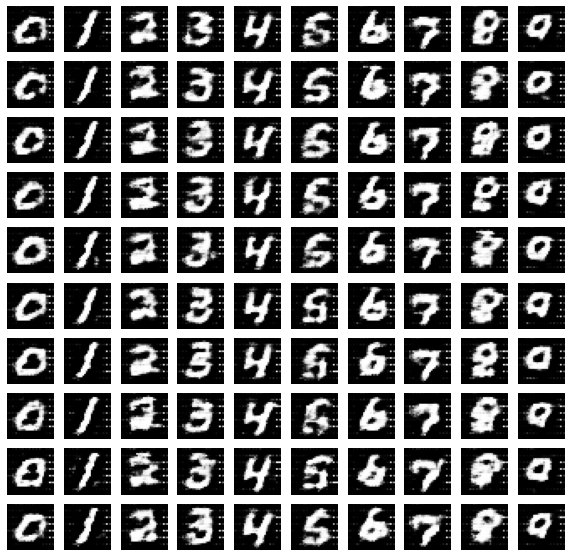

35 (0.34281086921691895, 0.0845654234290123, 0.3423762321472168, 0.010844451375305653, 0.7695020437240601, 0.013006818480789661)


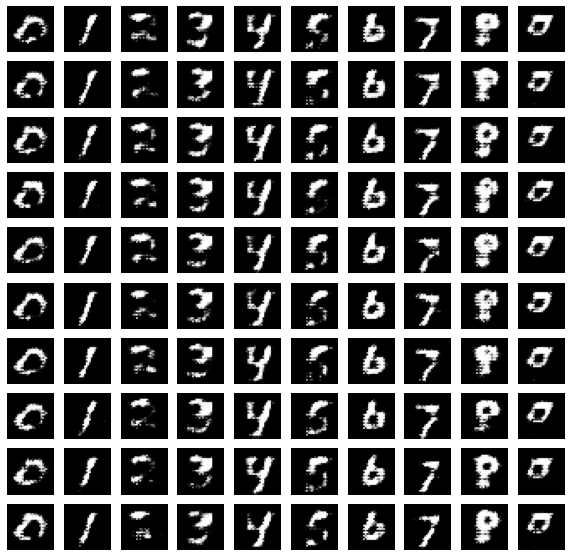

36 (0.33549532294273376, 0.10978665202856064, 0.3410506546497345, 0.0008621144806966186, 0.6533790230751038, 0.003563131671398878)


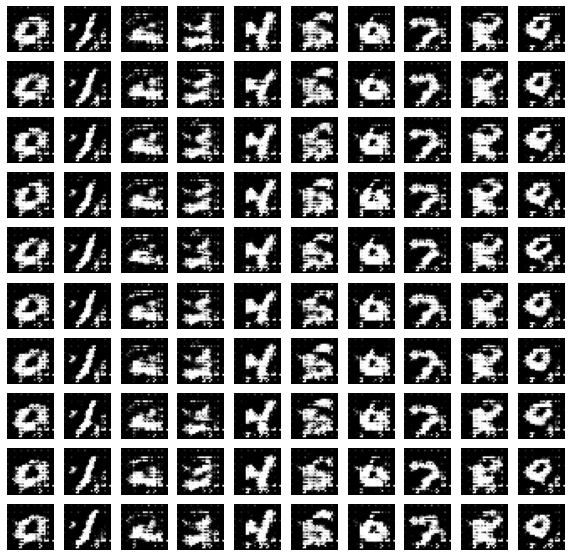

37 (0.33173543214797974, 0.12871716916561127, 0.33649274706840515, 0.0009257172932848334, 0.5902809500694275, 0.0011735608568415046)


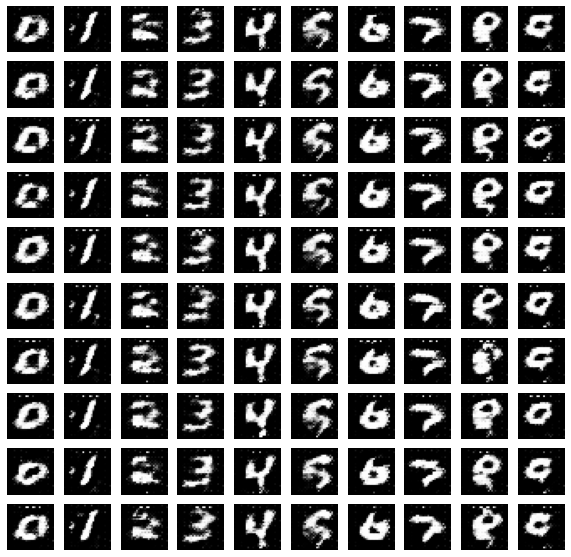

38 (0.33058780431747437, 0.12192185968160629, 0.33361053466796875, 0.0008103363797999918, 0.5956421494483948, 0.00041161285480484366)


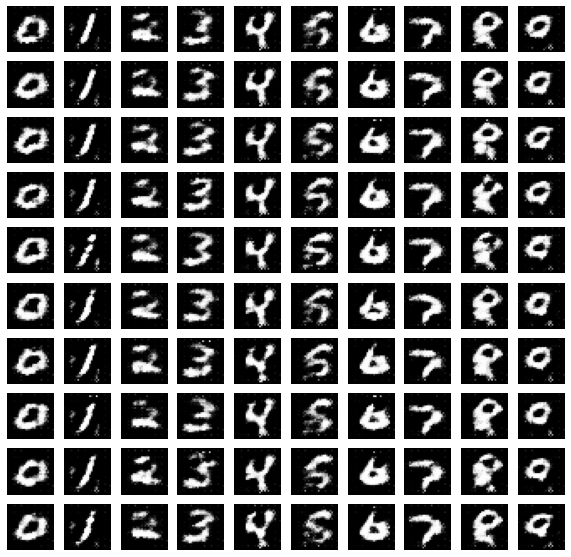

39 (0.3372041881084442, 0.06116076558828354, 0.335187703371048, 0.0005894509959034622, 0.665861964225769, 0.0008769446285441518)


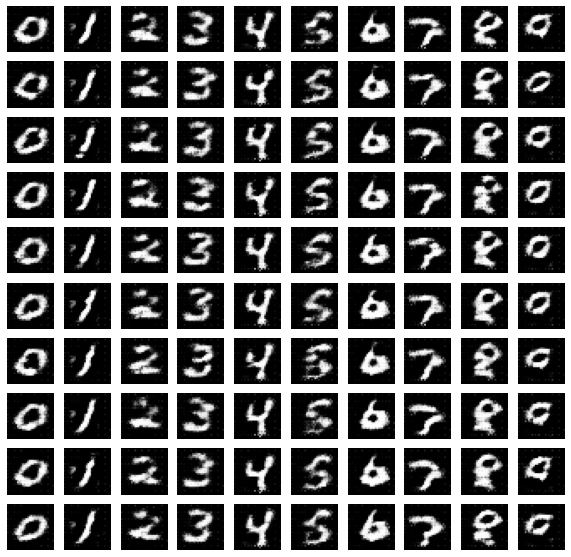

40 (0.33356618881225586, 0.11337113380432129, 0.34471431374549866, 0.001663404400460422, 0.5213412642478943, 0.008020619861781597)


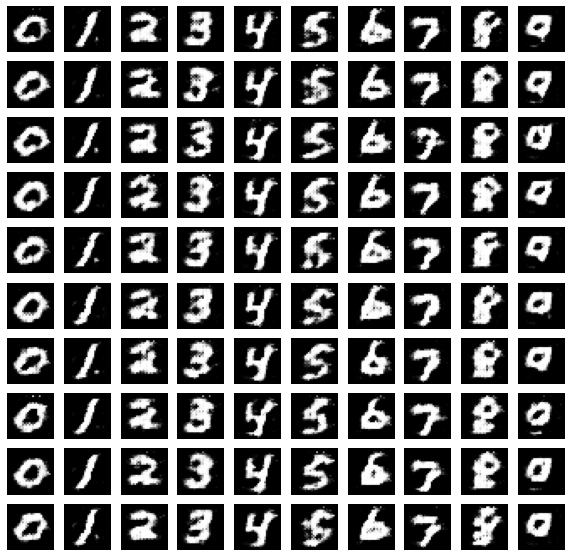

41 (0.33628302812576294, 0.227732315659523, 0.36154454946517944, 0.0017451829044148326, 0.7423269152641296, 0.011629692278802395)


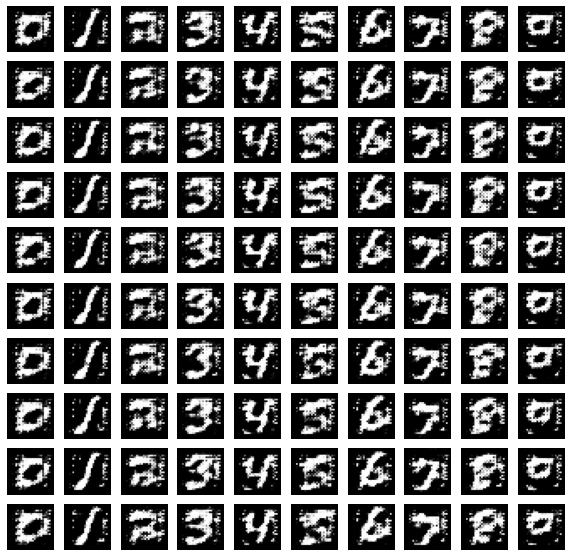

42 (0.3500964343547821, 0.04398007318377495, 0.3695234954357147, 0.001855551148764789, 0.489403635263443, 0.0038876994512975216)


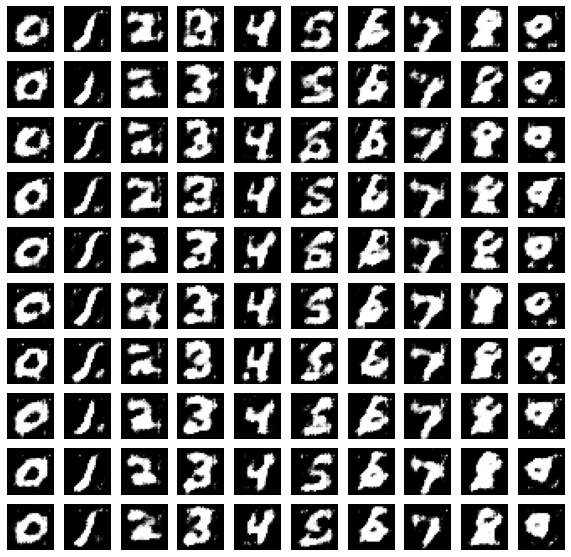

43 (0.3349702060222626, 0.125407874584198, 0.35278674960136414, 0.0015276320045813918, 0.8786144852638245, 0.002123749116435647)


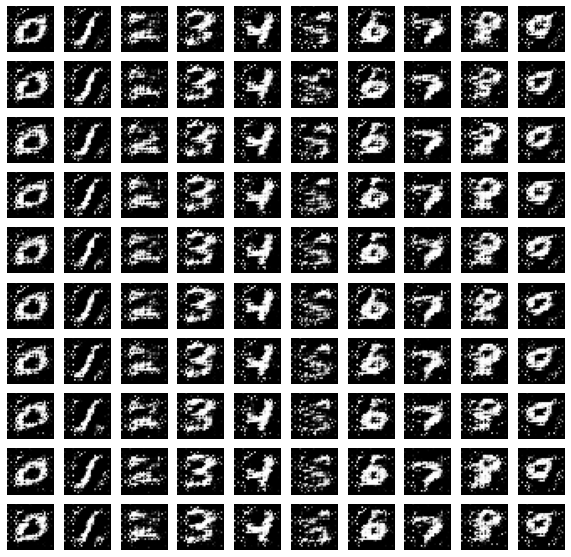

44 (0.3368307948112488, 0.12286742776632309, 0.3395201563835144, 0.0002604549517855048, 0.6646685004234314, 0.0005854815244674683)


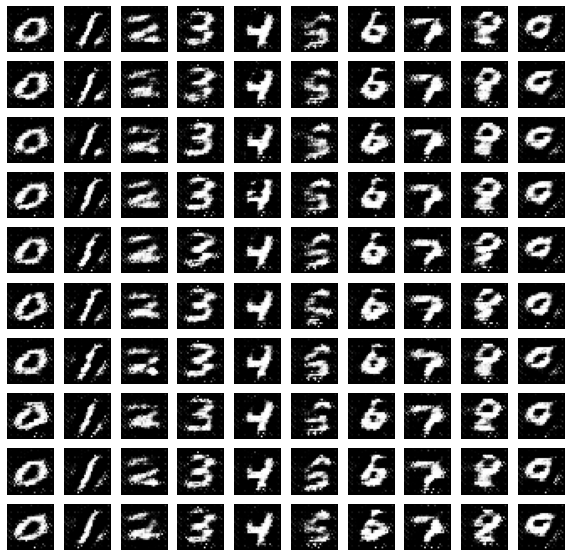

45 (0.33590584993362427, 0.07615524530410767, 0.3404899537563324, 0.0007420203764922917, 0.6542540788650513, 0.0005846243584528565)


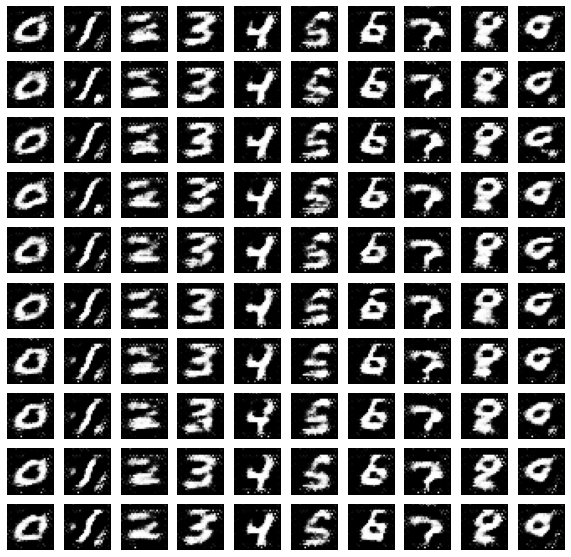

46 (0.3314281404018402, 0.1159864068031311, 0.3358166217803955, 0.0009038419811986387, 0.6180209517478943, 0.0006487123901024461)


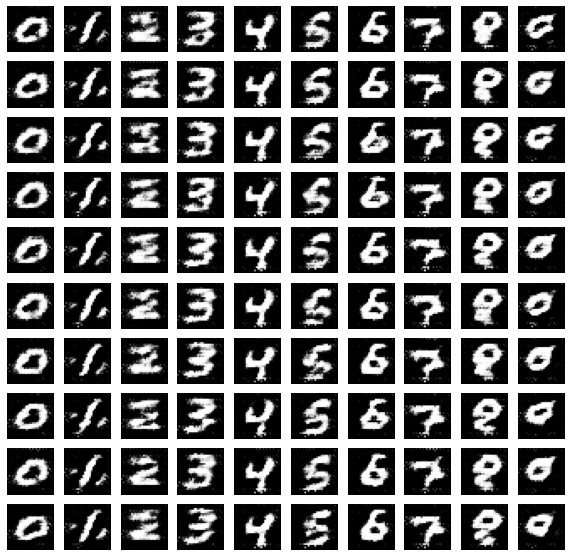

47 (0.35512107610702515, 0.08850572258234024, 0.36252710223197937, 0.0008318760083056986, 0.7940844297409058, 0.0008845253032632172)


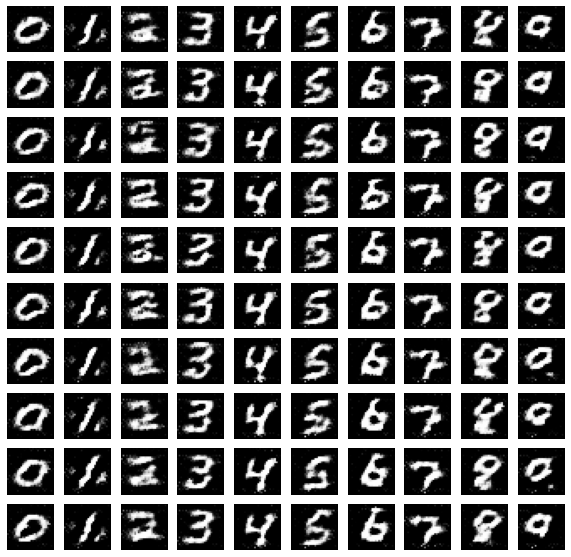

48 (0.3345988690853119, 0.11294189840555191, 0.335323303937912, 0.007849649526178837, 0.46332240104675293, 0.004062884021550417)


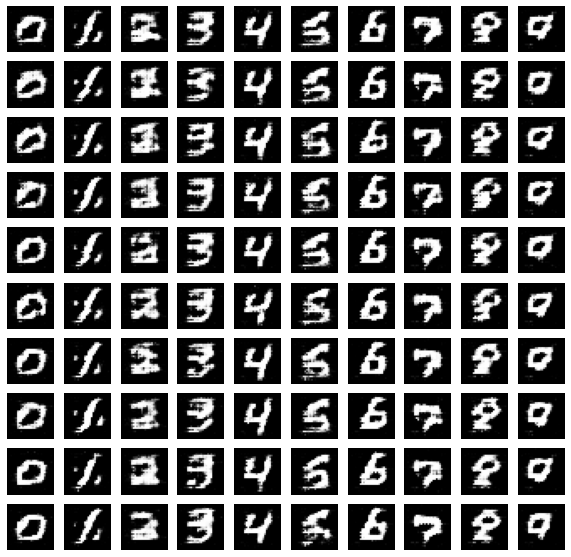

49 (0.3305533528327942, 0.07717399299144745, 0.33396977186203003, 0.002315225312486291, 0.578226625919342, 0.004721639212220907)


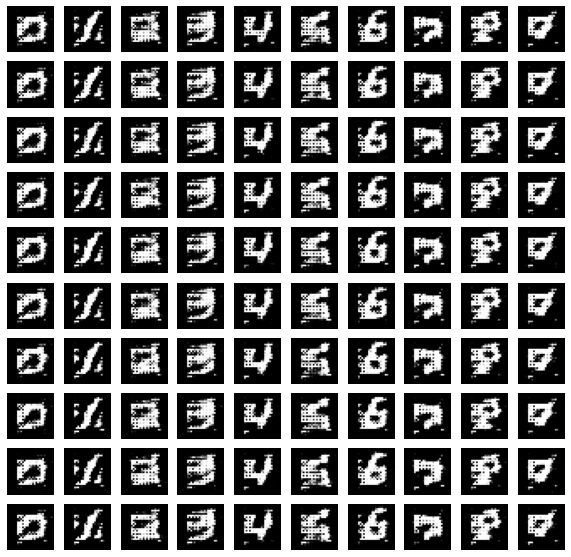

50 (0.32985827326774597, 0.05530330166220665, 0.3480178415775299, 0.0006738316151313484, 0.4702167510986328, 0.0007306026527658105)


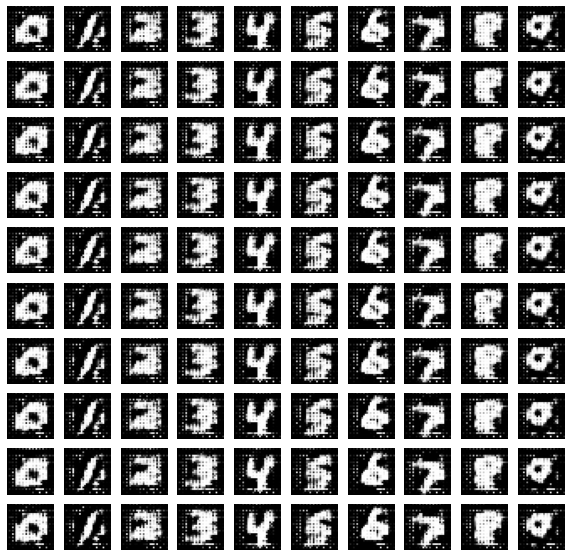

51 (0.33318305015563965, 0.12650446593761444, 0.35475876927375793, 0.0011267695808783174, 0.5974075198173523, 0.0017671387176960707)


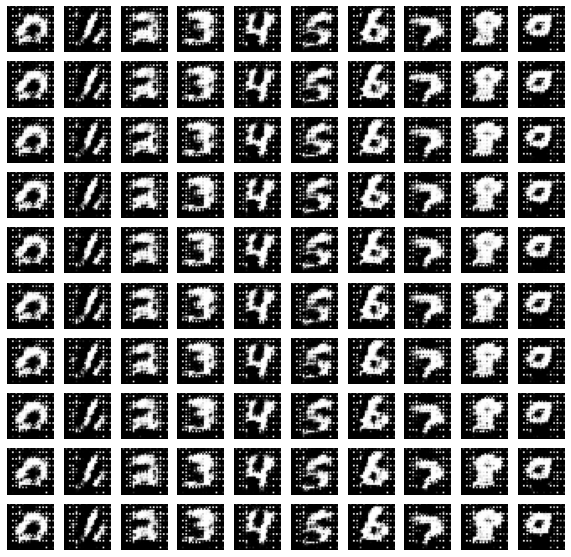

52 (0.33223792910575867, 0.051553875207901, 0.343615859746933, 0.0010888500837609172, 0.5359453558921814, 0.0014487033477053046)


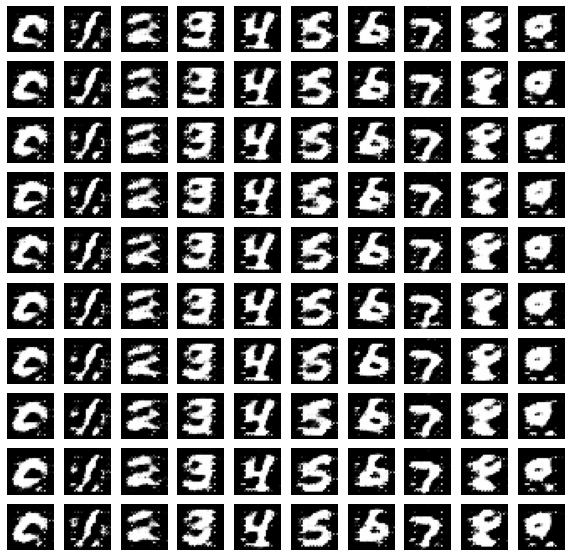

53 (0.3306959569454193, 0.1289874017238617, 0.3451666831970215, 0.0003896955749951303, 0.6959810256958008, 0.0005886596627533436)


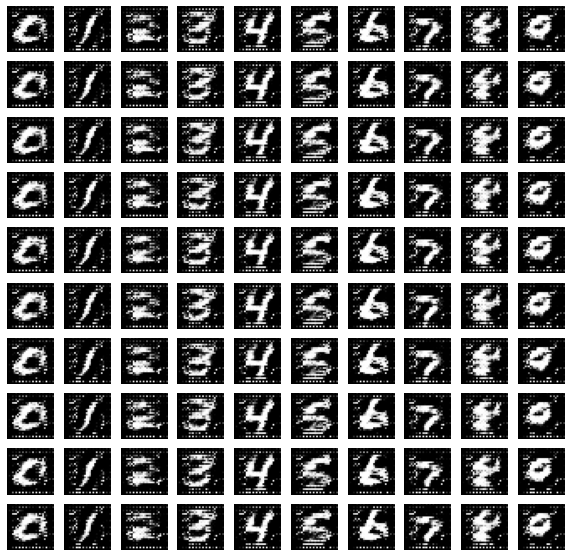

54 (0.3326578140258789, 0.07317281514406204, 0.34659090638160706, 0.0015442610019817948, 0.6451414823532104, 0.01132161170244217)


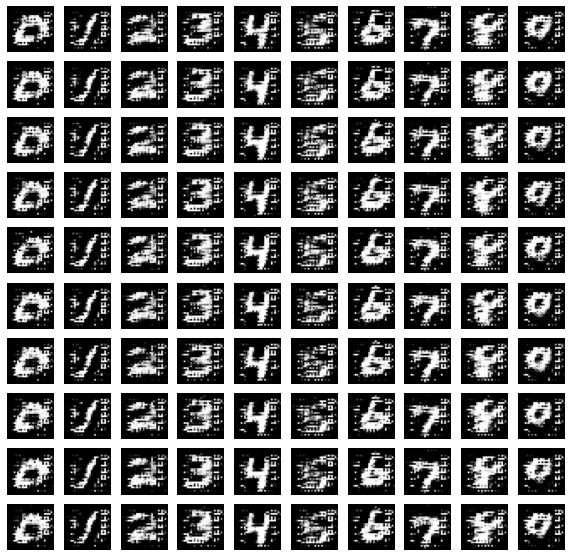

55 (0.33379364013671875, 0.20755386352539062, 0.34639373421669006, 0.001667086617089808, 0.6859089732170105, 0.0037543741054832935)


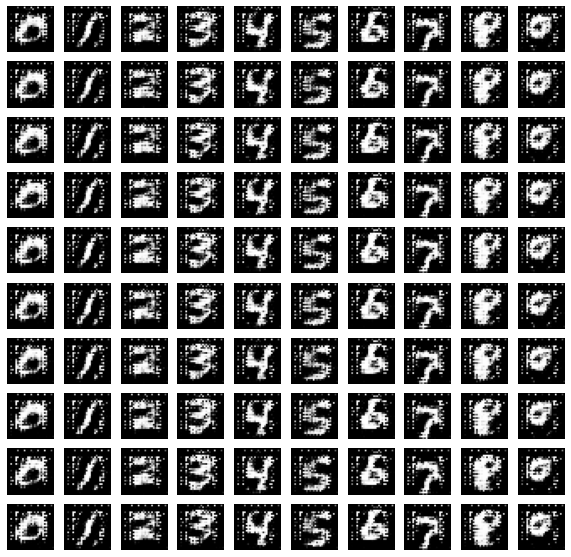

56 (0.3325202763080597, 0.08081122487783432, 0.3486183285713196, 0.00014792659203521907, 0.4289942681789398, 0.0030368324369192123)


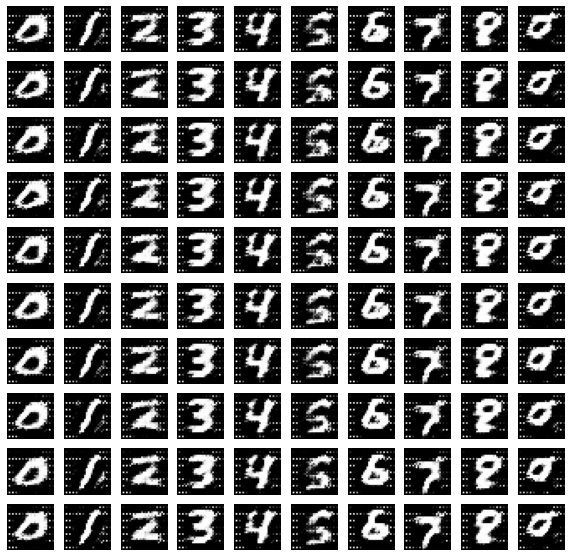

57 (0.33374664187431335, 0.142914280295372, 0.3608253002166748, 0.0045481896959245205, 0.49389171600341797, 0.0013597558718174696)


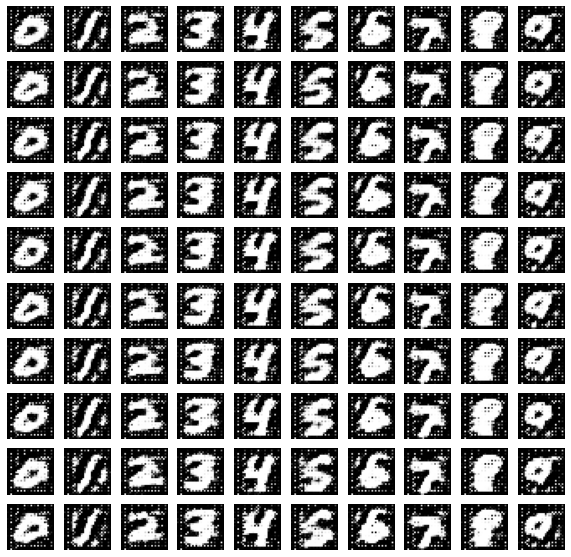

58 (0.3301582634449005, 0.0799393504858017, 0.3449200689792633, 0.00045786783448420465, 0.6951322555541992, 0.0035075636114925146)


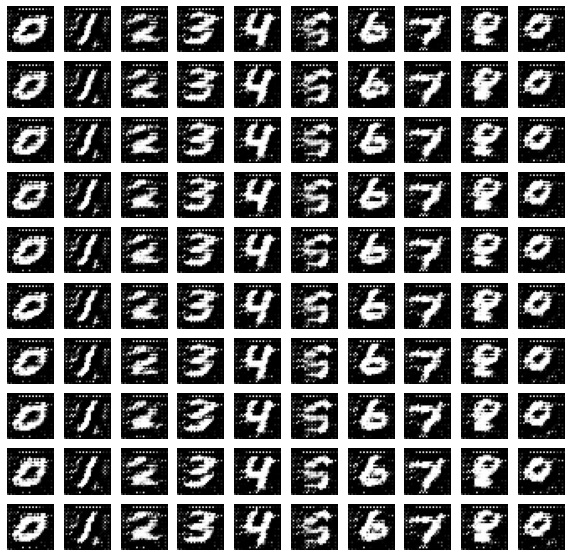

59 (0.33036190271377563, 0.1006486564874649, 0.33823227882385254, 0.000370730587746948, 0.699008584022522, 0.00041001924546435475)


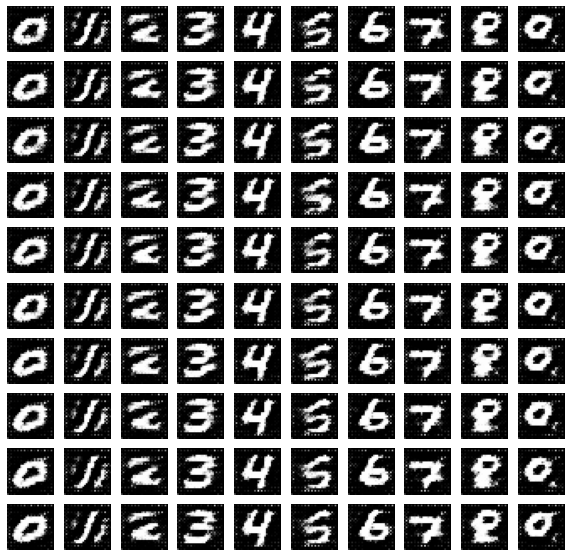

60 (0.32958507537841797, 0.09625505656003952, 0.33769410848617554, 0.000271491939201951, 0.6890169382095337, 0.0003403675800655037)


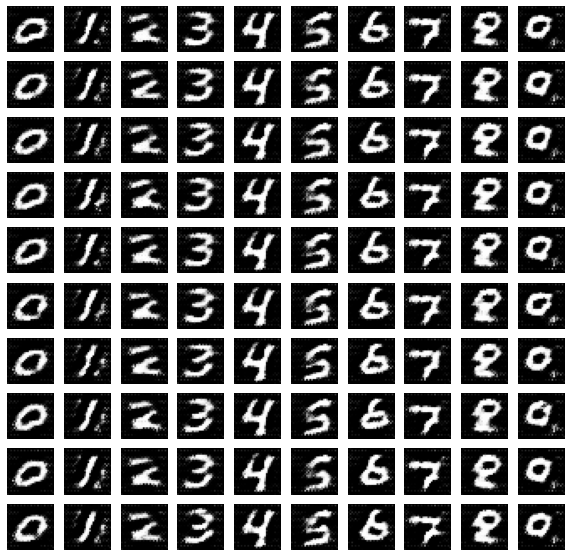

61 (0.3304184079170227, 0.13301752507686615, 0.3506414592266083, 0.002940885256975889, 0.6490829586982727, 0.0008344142115674913)


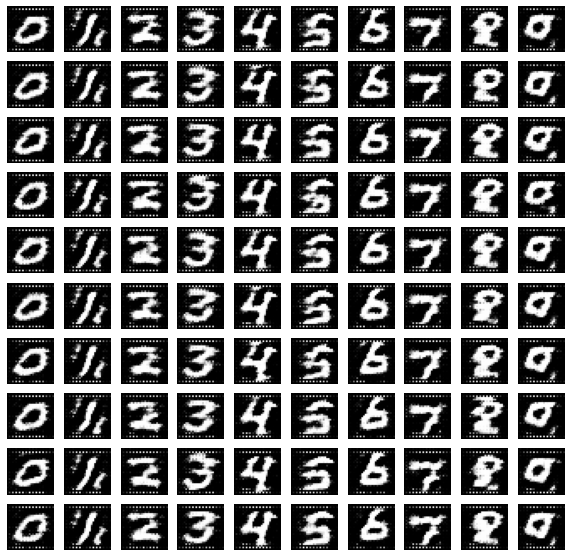

62 (0.3308682143688202, 0.035849679261446, 0.3415033221244812, 0.0014502967242151499, 0.726032555103302, 0.0016278100665658712)


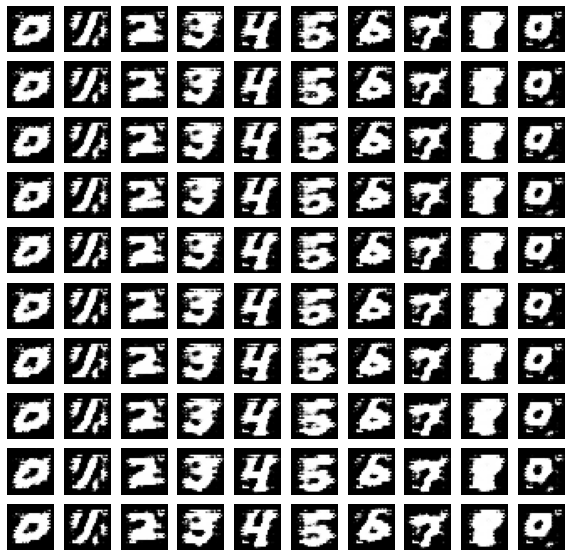

63 (0.6929861903190613, 0.04657881334424019, 0.6644085645675659, 0.000531072320882231, 1.144079327583313, 0.004071295261383057)


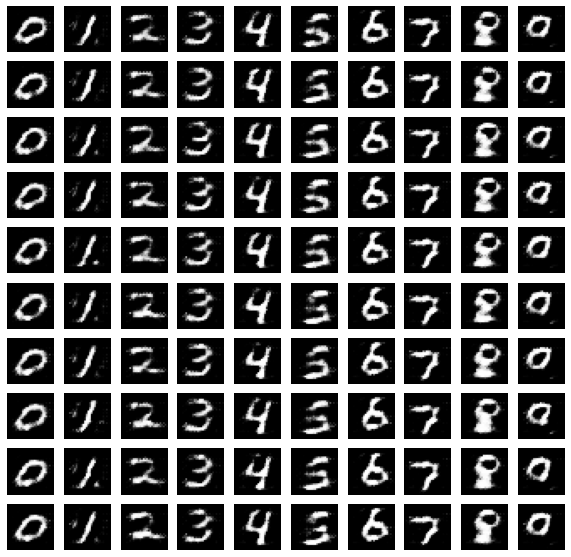

64 (0.330043762922287, 0.012167125940322876, 0.35652631521224976, 0.000366631371434778, 0.4270368218421936, 0.0007905261591076851)


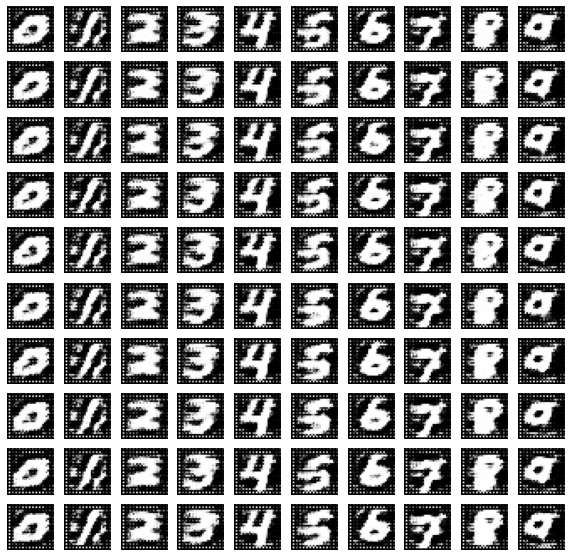

65 (0.32914209365844727, 0.12880371510982513, 0.34201163053512573, 0.000453868240583688, 0.5999878644943237, 0.0012057774001732469)


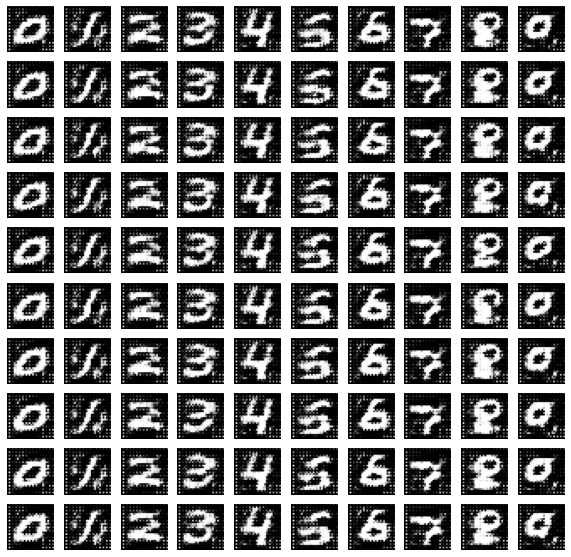

66 (0.33025380969047546, 0.049237433820962906, 0.3371202051639557, 0.0002627088688313961, 0.5996972322463989, 0.00025691709015518427)


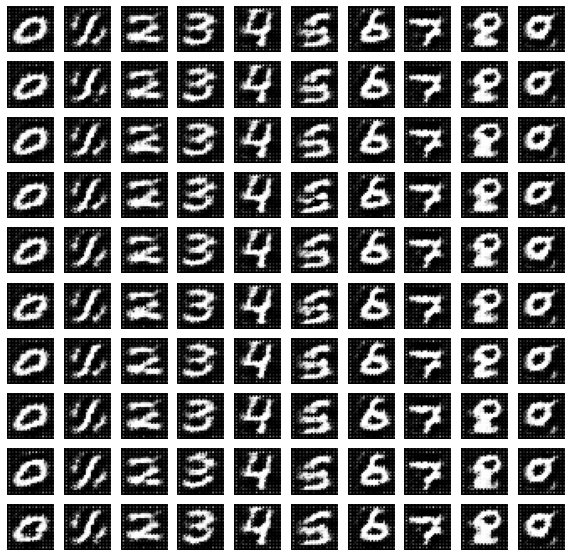

67 (0.32999855279922485, 0.09742021560668945, 0.33264636993408203, 0.0002753780281636864, 0.597109854221344, 0.0007087267003953457)


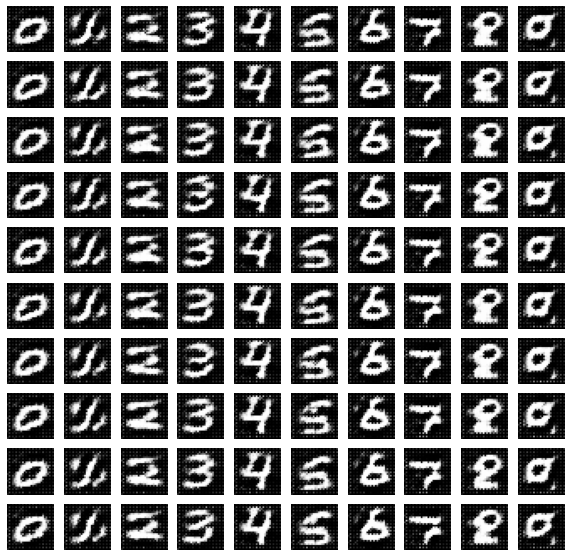

68 (0.33074328303337097, 0.19132767617702484, 0.33577731251716614, 0.00046647826093249023, 0.5737279653549194, 0.0012668961426243186)


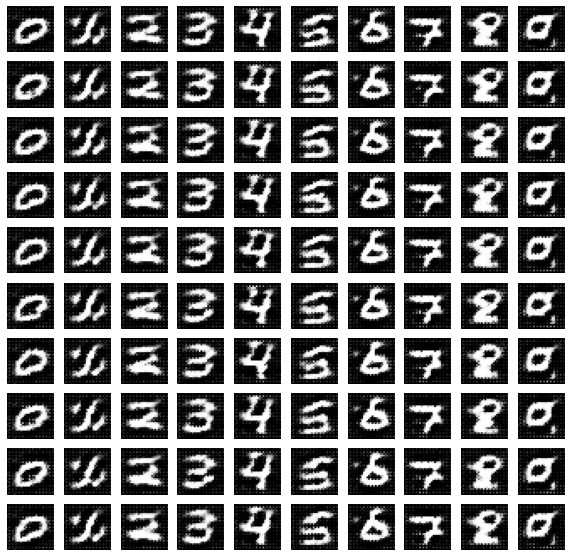

69 (0.3300134241580963, 0.16022393107414246, 0.33400648832321167, 0.0005659192684106529, 0.6228243112564087, 0.000595260935369879)


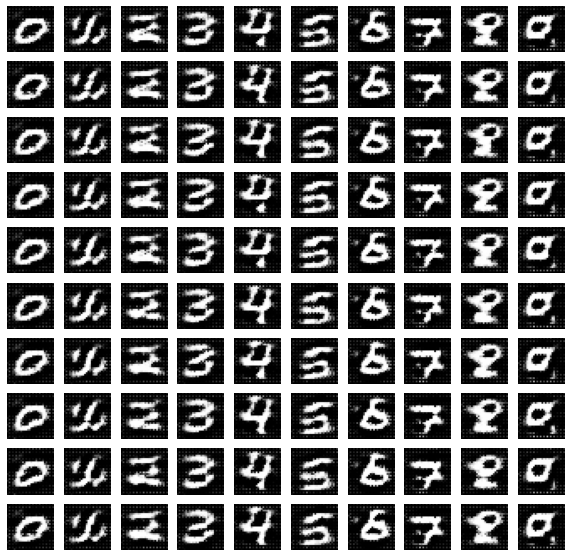

70 (0.32949694991111755, 0.026846449822187424, 0.3334096074104309, 0.00042495480738580227, 0.6317391991615295, 0.0005918313981965184)


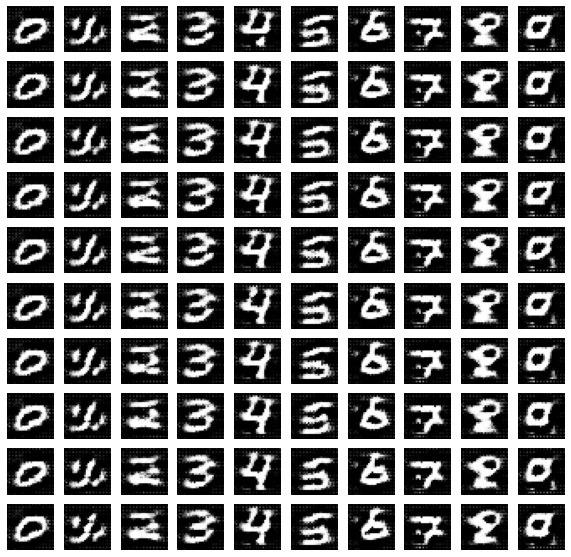

71 (0.3305298686027527, 0.09030062705278397, 0.33468589186668396, 0.0010873859282582998, 0.5896357297897339, 0.0005169702344574034)


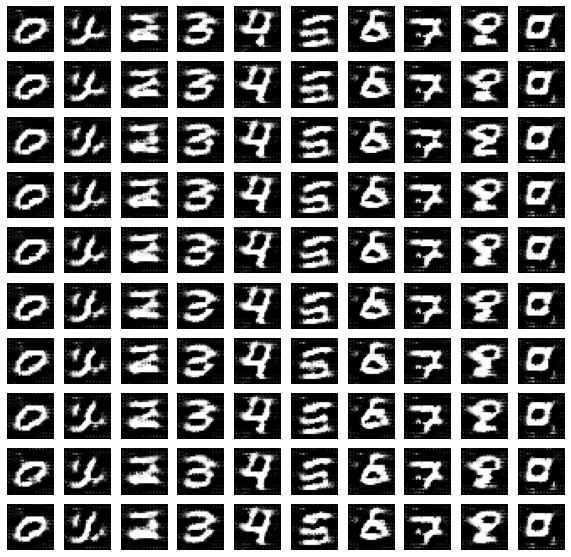

72 (0.32900121808052063, 0.10355917364358902, 0.3346128761768341, 0.0005889381864108145, 0.6174744367599487, 0.0009150617988780141)


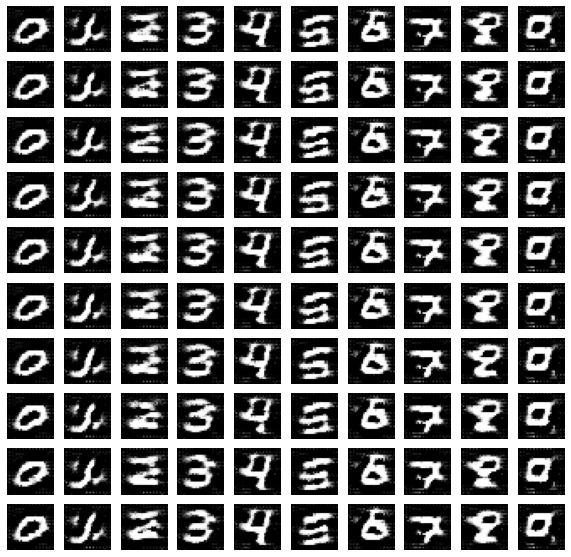

73 (0.3299364447593689, 0.03437390923500061, 0.3346661627292633, 0.00023910286836326122, 0.6230012774467468, 0.001096572494134307)


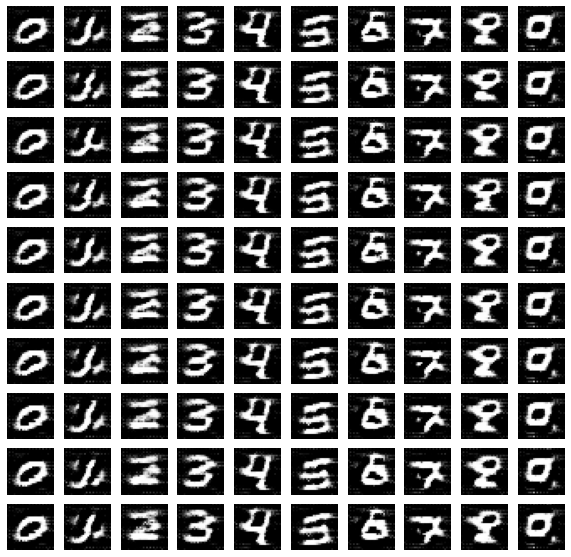

74 (0.32941216230392456, 0.07575851678848267, 0.3334644138813019, 0.0003965684154536575, 0.6637141108512878, 0.0008172038360498846)


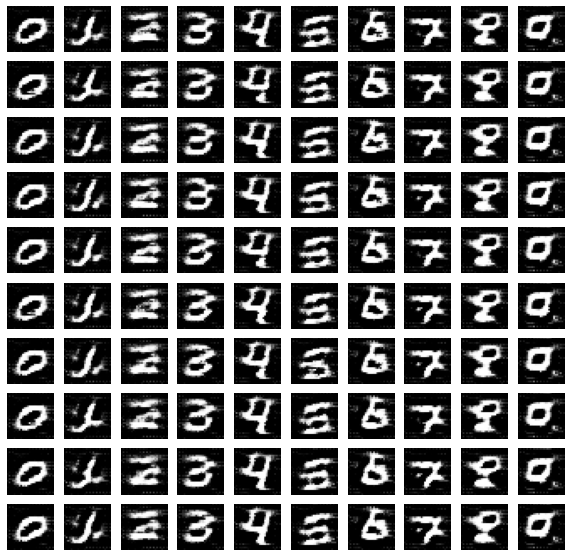

75 (0.3283722400665283, 0.0766475573182106, 0.336728036403656, 0.0006945277564227581, 0.6487583518028259, 0.0010505443206056952)


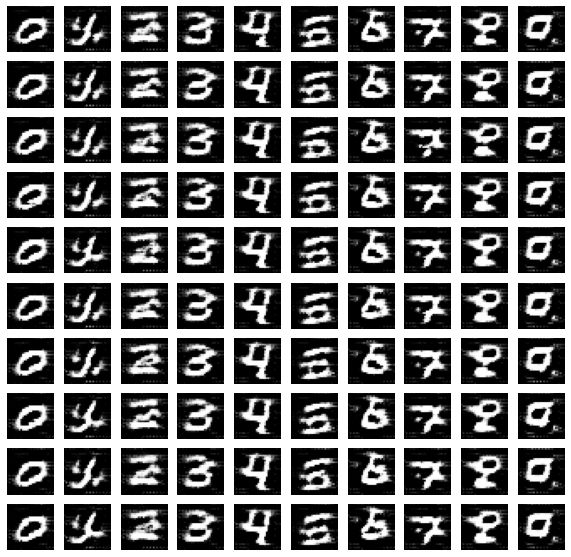

76 (0.3310239017009735, 0.07110176235437393, 0.3326009213924408, 0.0006041390588507056, 0.6288126111030579, 0.0010511738946661353)


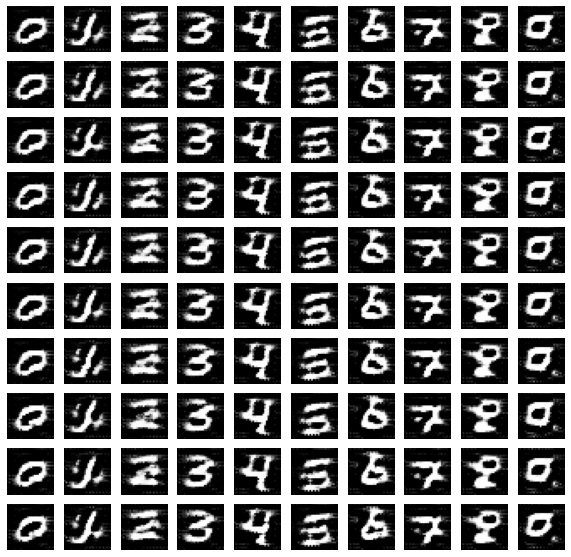

77 (0.32893112301826477, 0.11141777783632278, 0.3349435329437256, 0.0005744002992287278, 0.6038945317268372, 0.0008587889024056494)


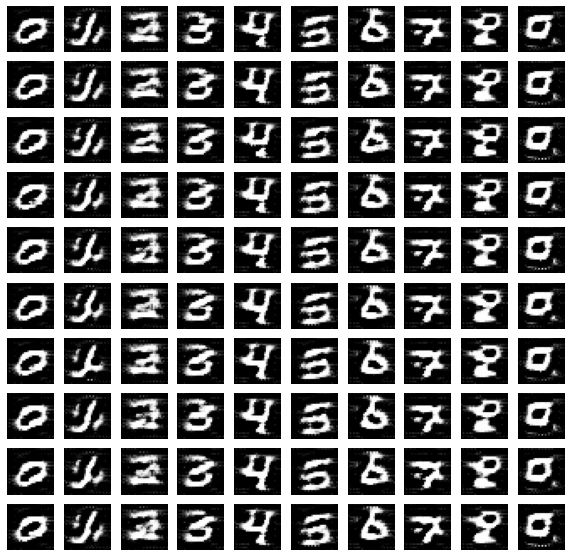

78 (0.33038029074668884, 0.2582673132419586, 0.33314651250839233, 0.00037797089316882193, 0.5902456045150757, 0.0007635175134055316)


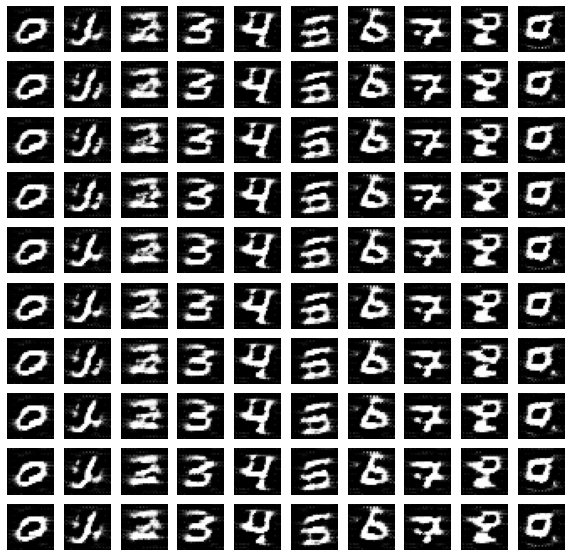

79 (0.33270853757858276, 0.11888984590768814, 0.33446764945983887, 0.0010520622599869967, 0.5702639222145081, 0.0005299264448694885)


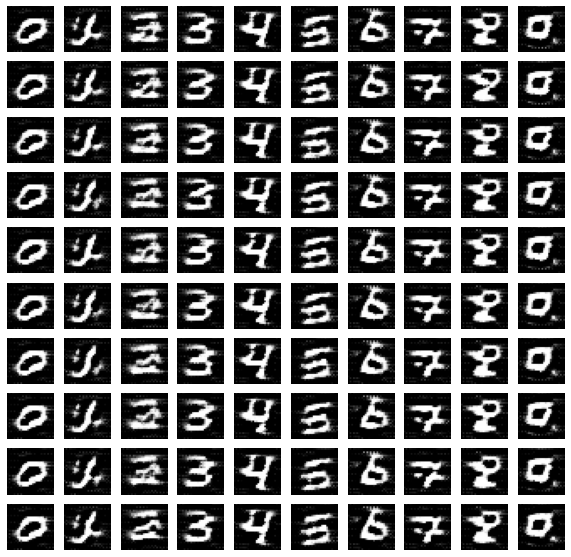

80 (0.3284618854522705, 0.12055231630802155, 0.3377237617969513, 0.0009466311312280595, 0.6654984354972839, 0.0019054862204939127)


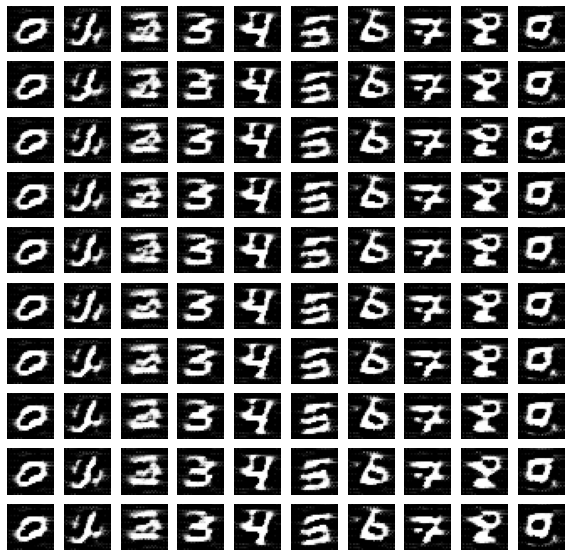

81 (0.32828474044799805, 0.0358375646173954, 0.33079004287719727, 0.00027057339320890605, 0.5950136184692383, 0.0010812852997332811)


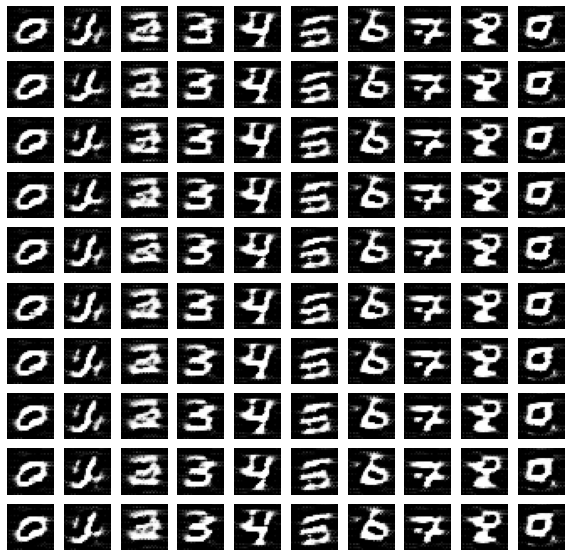

82 (0.32894665002822876, 0.08245086669921875, 0.33219224214553833, 0.0018655387684702873, 0.5878302454948425, 0.0010791363893076777)


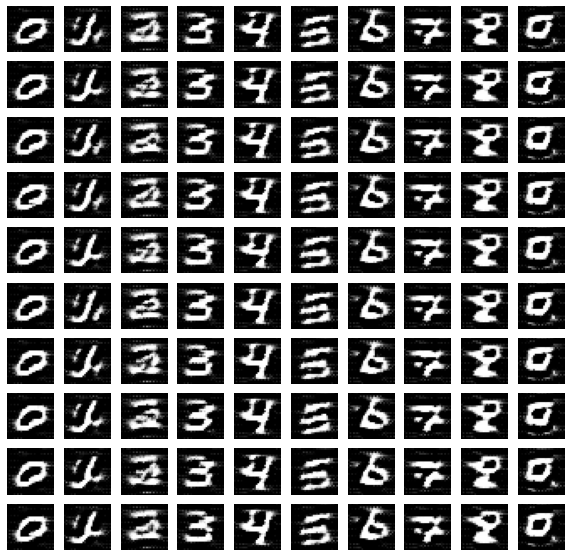

83 (0.32901930809020996, 0.0977708026766777, 0.33314427733421326, 0.0006111522088758647, 0.5997285842895508, 0.0013633713824674487)


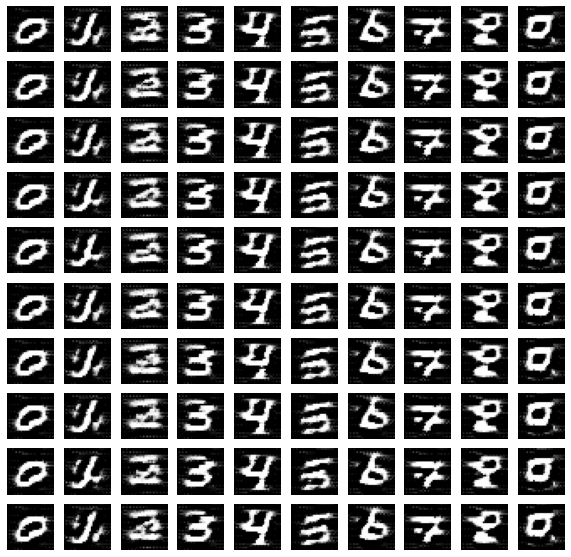

84 (0.32939982414245605, 0.1341099888086319, 0.3302556574344635, 0.00029847011319361627, 0.6516424417495728, 0.0014125648885965347)


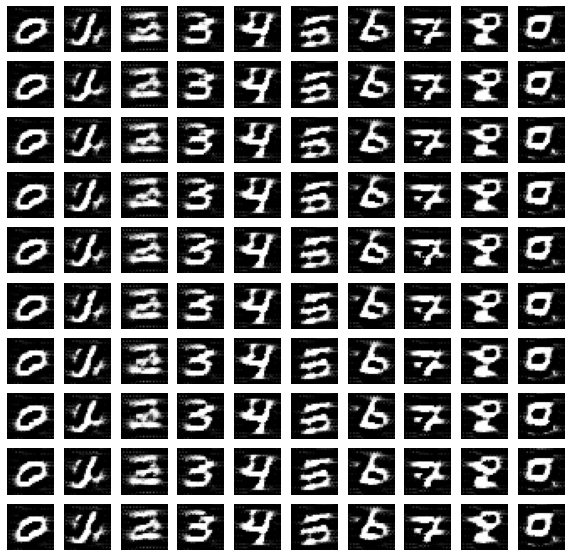

85 (0.32948538661003113, 0.18402768671512604, 0.33460813760757446, 0.0005192283424548805, 0.596812903881073, 0.009930558502674103)


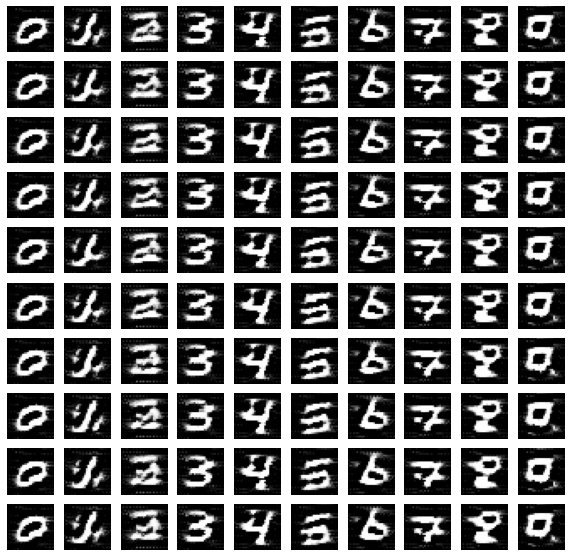

86 (0.3280923664569855, 0.05860733240842819, 0.33220747113227844, 0.0002300879277754575, 0.6169186234474182, 0.0012550029205158353)


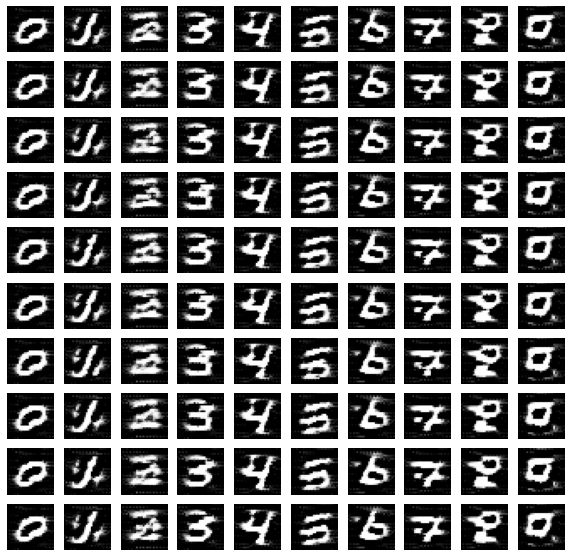

87 (0.32910212874412537, 0.01919974945485592, 0.3332420885562897, 0.0007790916715748608, 0.6422790884971619, 0.0007776420679874718)


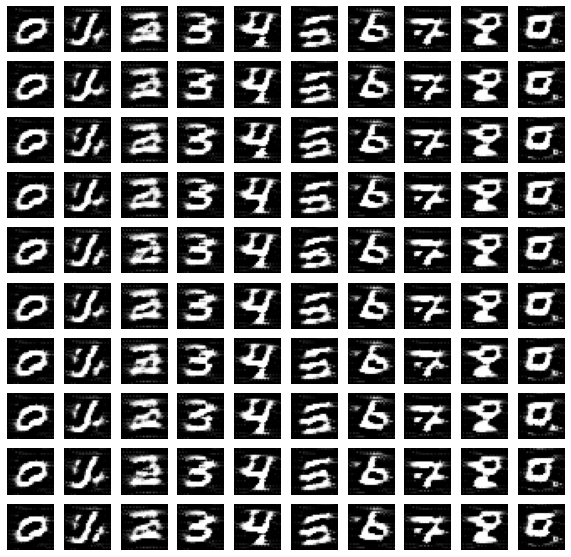

88 (0.33015555143356323, 0.051938943564891815, 0.3312918245792389, 0.0004616414080373943, 0.6111684441566467, 0.000402029458200559)


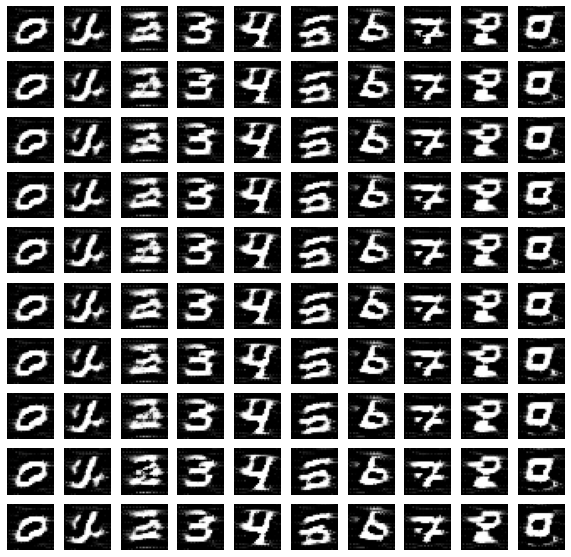

89 (0.3280947208404541, 0.05645429715514183, 0.33186668157577515, 0.0004179492243565619, 0.6129749417304993, 0.00027204188518226147)


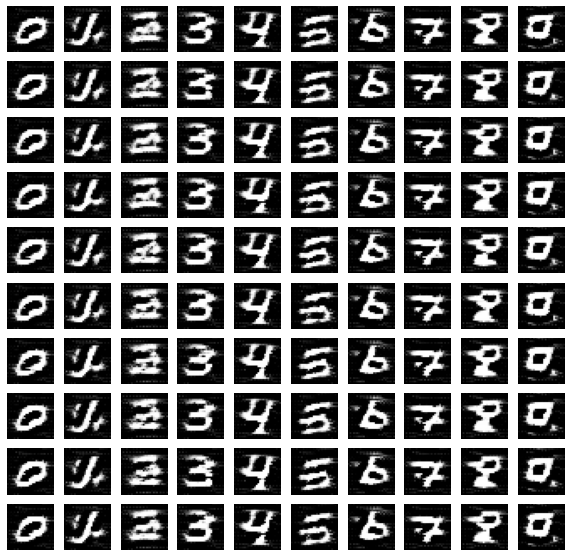

90 (0.32869863510131836, 0.1095864549279213, 0.32959607243537903, 0.0009488222422078252, 0.6037579774856567, 0.0008117396500892937)


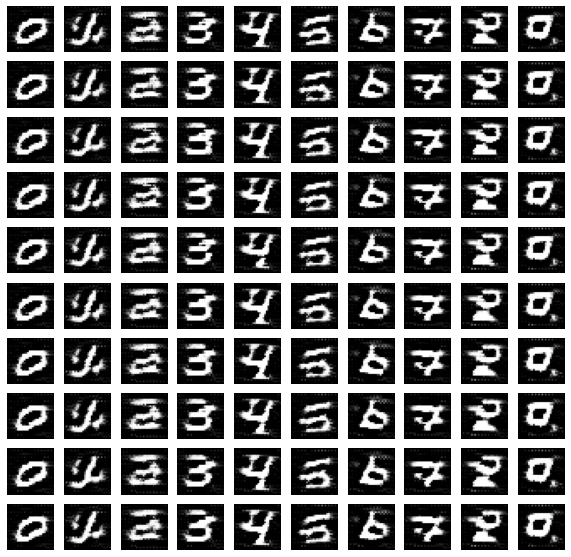

91 (0.3285136818885803, 0.07985736429691315, 0.3304286301136017, 0.0003219291684217751, 0.5872896909713745, 0.0007671345956623554)


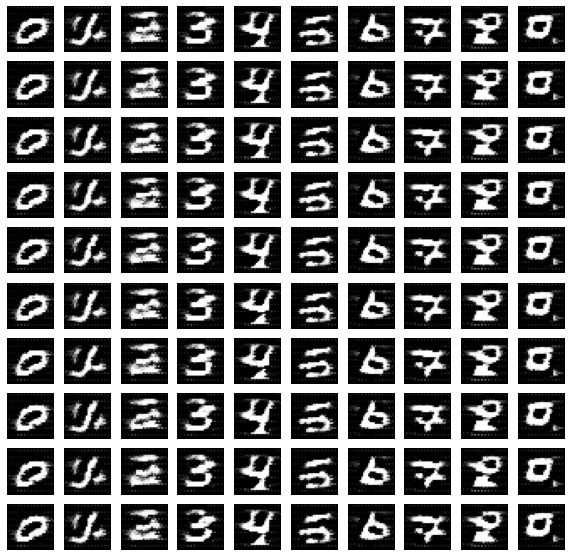

92 (0.3279741704463959, 0.1499170958995819, 0.33150097727775574, 0.00047202763380482793, 0.5638495087623596, 0.0005885487189516425)


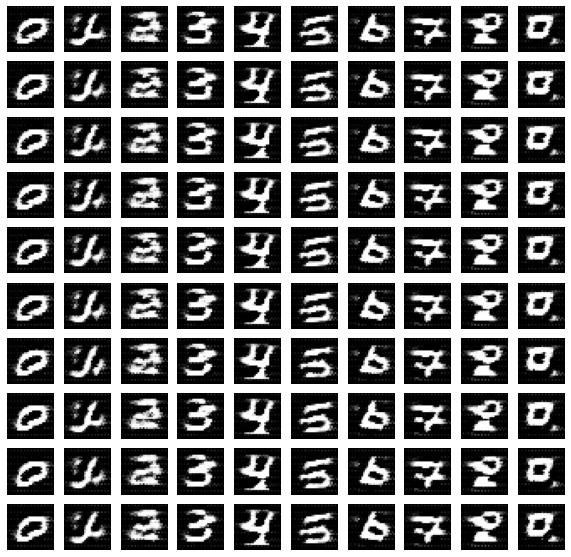

93 (0.32780393958091736, 0.039225075393915176, 0.3321625888347626, 0.0004281385336071253, 0.5254878997802734, 0.0005217062425799668)


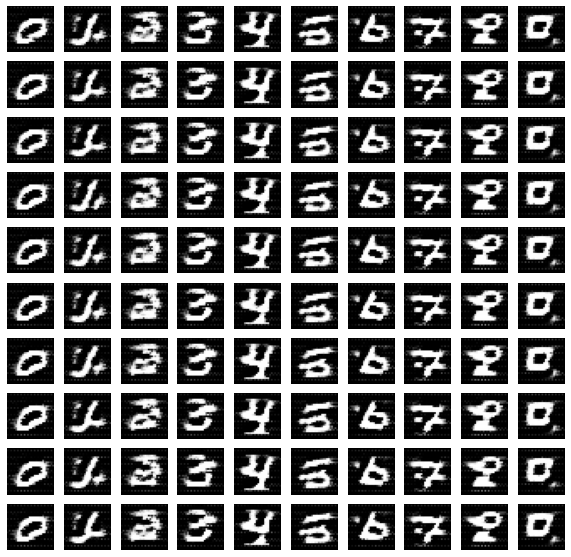

94 (0.32814571261405945, 0.05965210869908333, 0.33071255683898926, 0.00030340199009515345, 0.593357503414154, 0.0011391276493668556)


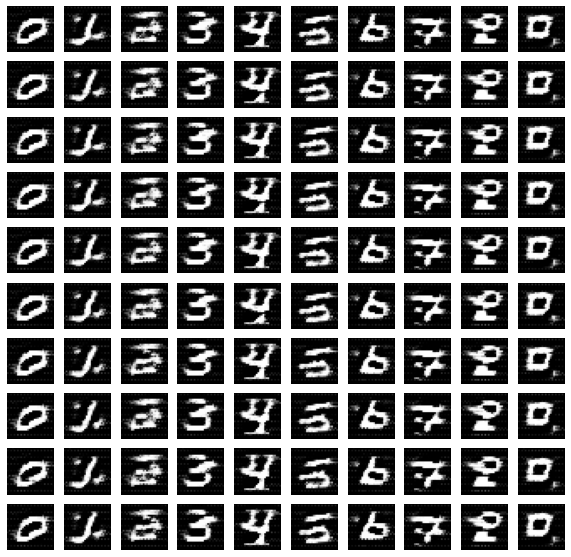

95 (0.32889237999916077, 0.044542793184518814, 0.3304964005947113, 0.0002108880871674046, 0.6063812375068665, 0.0003891267697326839)


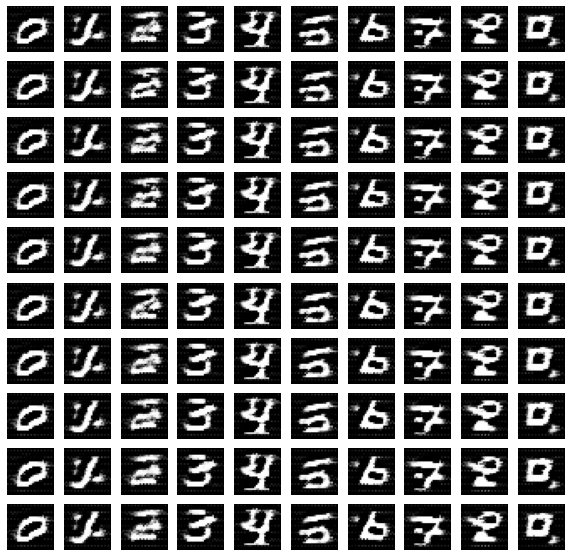

96 (0.32828378677368164, 0.17677496373653412, 0.3303970992565155, 0.0002599969448056072, 0.6041340827941895, 0.0006721768877469003)


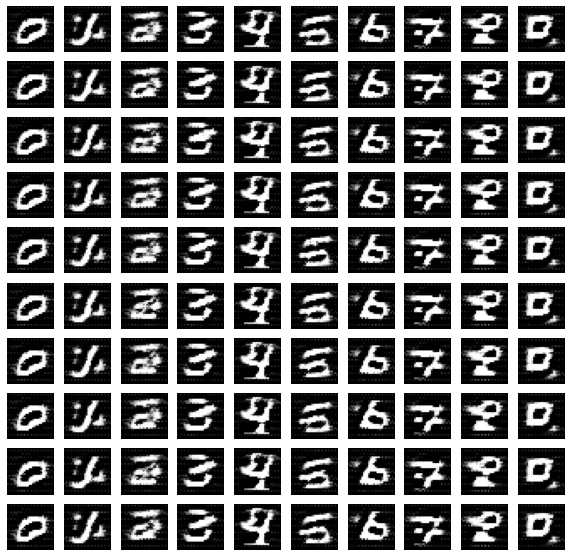

97 (0.3293210566043854, 0.04137951508164406, 0.33172932267189026, 0.0009472068632021546, 0.6269506812095642, 0.0013746655313298106)


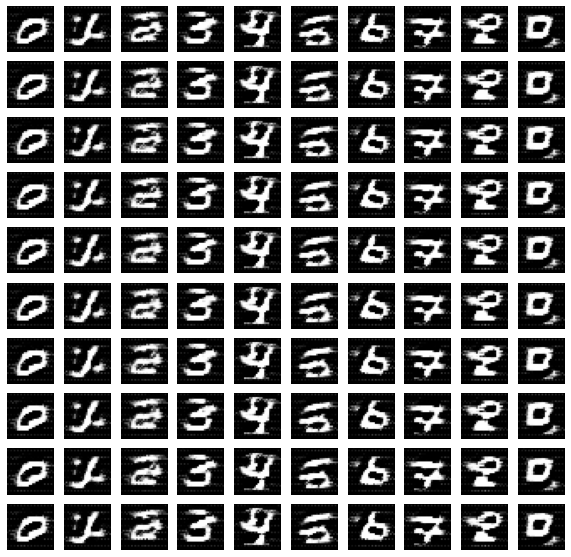

98 (0.3272307515144348, 0.07842551171779633, 0.3288419246673584, 0.0007033792207948864, 0.5908516645431519, 0.000590114388614893)


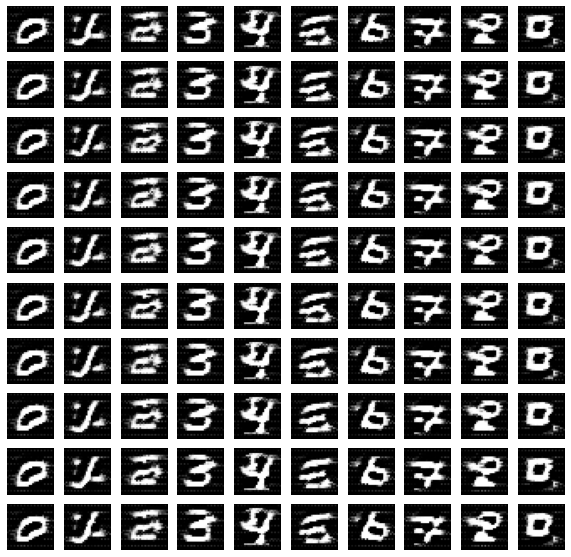

99 (0.3285049498081207, 0.1822628229856491, 0.3305705487728119, 0.00029570396873168647, 0.5840219259262085, 0.0011001109378412366)


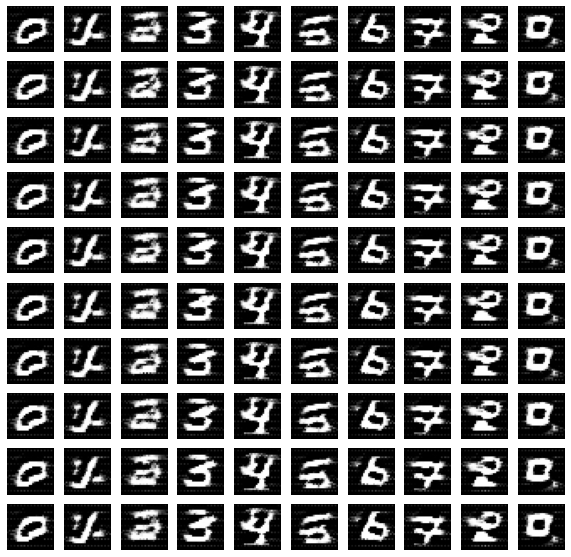

{'dLoss': array([], dtype=float64), 'gLoss': array([], dtype=float64)}

In [ ]:
!mkdir out 
!rm out/*.jpg
d = build_discriminator()
g = build_generator()
gan = build_gan(d,g)
epoch(g,d,gan,dataset,100)

In [ ]:
from tensorflow.keras.models import save_model
save_model(d,"discriminatorACGAN")
save_model(g,"generatorACGAN")

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: discriminatorACGAN/assets
INFO:tensorflow:Assets written to: generatorACGAN/assets


In [ ]:
!tar czf acgan.tar.gz generatorACGAN  discriminatorACGAN out
